# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

A subdirectory or file data already exists.


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [00:19, 9.26MB/s]                                                                             
SVHN Testing Set: 64.3MB [00:09, 6.81MB/s]                                                                             


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

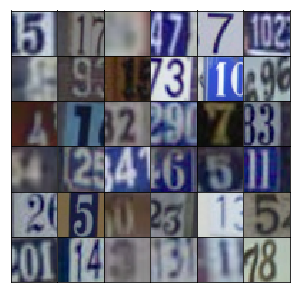

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [25]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        x1 = tf.reshape(x1, (-1, 4,4,512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [52]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        x1 = tf.maximum(alpha * x1, x1)
        
        x2 = tf.layers.conv2d(x1, 128, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=True)
        x2 = tf.maximum(alpha * x2, alpha)
        
        x3 = tf.layers.conv2d(x2, 256, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=True)
        x3 = tf.maximum(alpha * x3, alpha)
        
        
        x3 = tf.reshape(x3, (-1, 4*4*256))
        logits = tf.layers.dense(x3, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [53]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [54]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [55]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [56]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [57]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [62]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 64
epochs = 10
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/10... Discriminator Loss: 1.2585... Generator Loss: 0.7653
Epoch 1/10... Discriminator Loss: 0.9792... Generator Loss: 0.9891
Epoch 1/10... Discriminator Loss: 1.2328... Generator Loss: 0.7558
Epoch 1/10... Discriminator Loss: 1.2006... Generator Loss: 0.7922
Epoch 1/10... Discriminator Loss: 1.2855... Generator Loss: 0.7066
Epoch 1/10... Discriminator Loss: 1.2293... Generator Loss: 0.8294
Epoch 1/10... Discriminator Loss: 1.3187... Generator Loss: 0.6593
Epoch 1/10... Discriminator Loss: 1.3443... Generator Loss: 0.6988
Epoch 1/10... Discriminator Loss: 1.3452... Generator Loss: 0.6947
Epoch 1/10... Discriminator Loss: 1.2803... Generator Loss: 0.6604


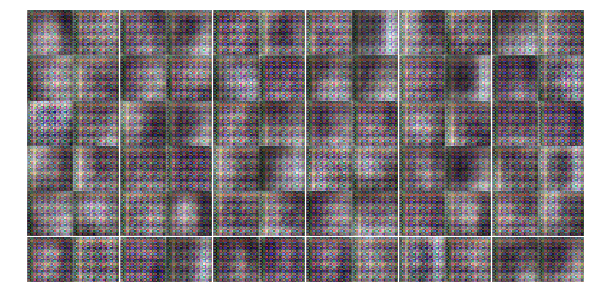

Epoch 1/10... Discriminator Loss: 1.2428... Generator Loss: 0.8766
Epoch 1/10... Discriminator Loss: 1.2931... Generator Loss: 0.6787
Epoch 1/10... Discriminator Loss: 1.2878... Generator Loss: 0.6596
Epoch 1/10... Discriminator Loss: 1.3817... Generator Loss: 0.6545
Epoch 1/10... Discriminator Loss: 1.3256... Generator Loss: 0.6899
Epoch 1/10... Discriminator Loss: 1.2895... Generator Loss: 0.7602
Epoch 1/10... Discriminator Loss: 1.2677... Generator Loss: 0.7926
Epoch 1/10... Discriminator Loss: 1.2792... Generator Loss: 0.6973
Epoch 1/10... Discriminator Loss: 1.2824... Generator Loss: 0.6797
Epoch 1/10... Discriminator Loss: 1.4338... Generator Loss: 0.5788


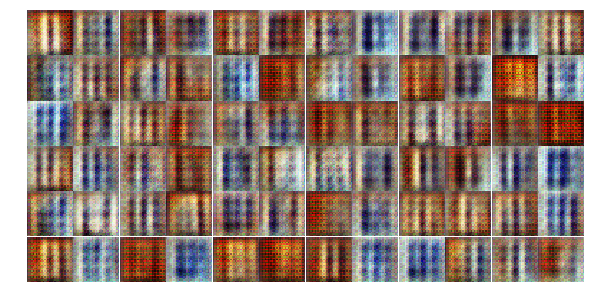

Epoch 1/10... Discriminator Loss: 1.3548... Generator Loss: 0.6949
Epoch 1/10... Discriminator Loss: 1.2192... Generator Loss: 0.7829
Epoch 1/10... Discriminator Loss: 1.1052... Generator Loss: 0.8390
Epoch 1/10... Discriminator Loss: 1.3255... Generator Loss: 0.6975
Epoch 1/10... Discriminator Loss: 1.3089... Generator Loss: 0.6909
Epoch 1/10... Discriminator Loss: 1.1768... Generator Loss: 0.7263
Epoch 1/10... Discriminator Loss: 1.3030... Generator Loss: 0.7301
Epoch 1/10... Discriminator Loss: 1.0442... Generator Loss: 1.0849
Epoch 1/10... Discriminator Loss: 1.2716... Generator Loss: 0.6899
Epoch 1/10... Discriminator Loss: 1.2146... Generator Loss: 0.7071


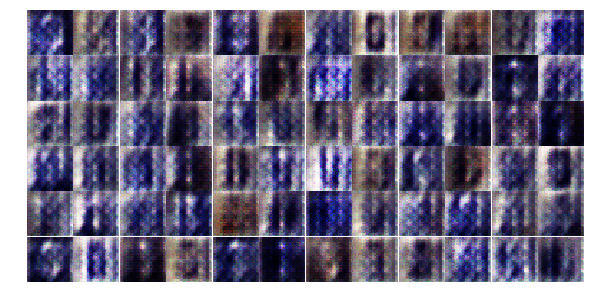

Epoch 1/10... Discriminator Loss: 1.2836... Generator Loss: 0.6645
Epoch 1/10... Discriminator Loss: 1.3390... Generator Loss: 0.7838
Epoch 1/10... Discriminator Loss: 1.3527... Generator Loss: 0.6968
Epoch 1/10... Discriminator Loss: 1.3291... Generator Loss: 0.6808
Epoch 1/10... Discriminator Loss: 1.2695... Generator Loss: 0.7887
Epoch 1/10... Discriminator Loss: 1.3411... Generator Loss: 0.6838
Epoch 1/10... Discriminator Loss: 1.2804... Generator Loss: 0.7992
Epoch 1/10... Discriminator Loss: 1.2440... Generator Loss: 0.7695
Epoch 1/10... Discriminator Loss: 1.3197... Generator Loss: 0.7095
Epoch 1/10... Discriminator Loss: 1.3117... Generator Loss: 0.7301


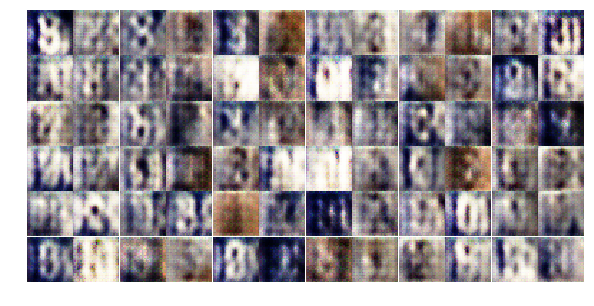

Epoch 1/10... Discriminator Loss: 1.3222... Generator Loss: 0.7407
Epoch 1/10... Discriminator Loss: 1.3230... Generator Loss: 0.7634
Epoch 1/10... Discriminator Loss: 1.3157... Generator Loss: 0.7271
Epoch 1/10... Discriminator Loss: 1.2857... Generator Loss: 0.7467
Epoch 1/10... Discriminator Loss: 1.2476... Generator Loss: 0.8599
Epoch 1/10... Discriminator Loss: 1.2522... Generator Loss: 0.7652
Epoch 1/10... Discriminator Loss: 1.2870... Generator Loss: 0.7789
Epoch 1/10... Discriminator Loss: 1.2471... Generator Loss: 0.7071
Epoch 1/10... Discriminator Loss: 1.3449... Generator Loss: 0.6811
Epoch 1/10... Discriminator Loss: 1.3199... Generator Loss: 0.7385


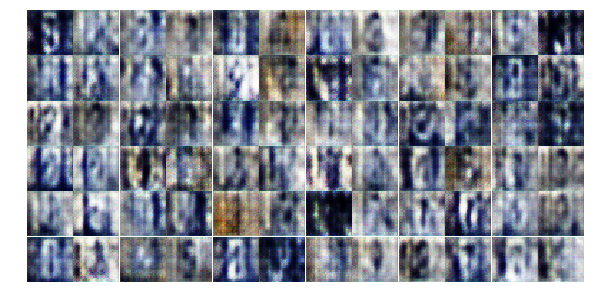

Epoch 1/10... Discriminator Loss: 1.3213... Generator Loss: 0.6384
Epoch 1/10... Discriminator Loss: 1.3176... Generator Loss: 0.6874
Epoch 1/10... Discriminator Loss: 1.3943... Generator Loss: 0.6769
Epoch 1/10... Discriminator Loss: 1.2936... Generator Loss: 0.6826
Epoch 1/10... Discriminator Loss: 1.2883... Generator Loss: 0.8250
Epoch 1/10... Discriminator Loss: 1.3963... Generator Loss: 0.6959
Epoch 1/10... Discriminator Loss: 1.3043... Generator Loss: 0.7346
Epoch 1/10... Discriminator Loss: 1.3291... Generator Loss: 0.7829
Epoch 1/10... Discriminator Loss: 1.3798... Generator Loss: 0.6488
Epoch 1/10... Discriminator Loss: 1.3218... Generator Loss: 0.7225


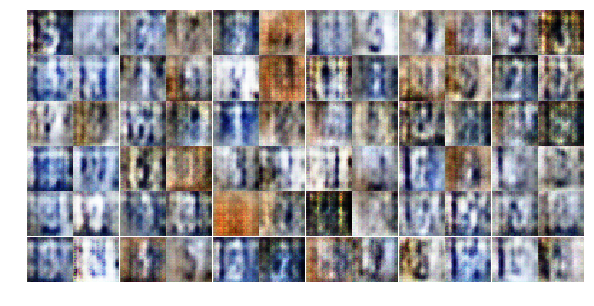

Epoch 1/10... Discriminator Loss: 1.3170... Generator Loss: 0.7039
Epoch 1/10... Discriminator Loss: 1.3381... Generator Loss: 0.7430
Epoch 1/10... Discriminator Loss: 1.3557... Generator Loss: 0.7436
Epoch 1/10... Discriminator Loss: 1.3155... Generator Loss: 0.7175
Epoch 1/10... Discriminator Loss: 1.3552... Generator Loss: 0.6872
Epoch 1/10... Discriminator Loss: 1.3615... Generator Loss: 0.6963
Epoch 1/10... Discriminator Loss: 1.3128... Generator Loss: 0.7333
Epoch 1/10... Discriminator Loss: 1.3376... Generator Loss: 0.7088
Epoch 1/10... Discriminator Loss: 1.3587... Generator Loss: 0.7226
Epoch 1/10... Discriminator Loss: 1.3671... Generator Loss: 0.6909


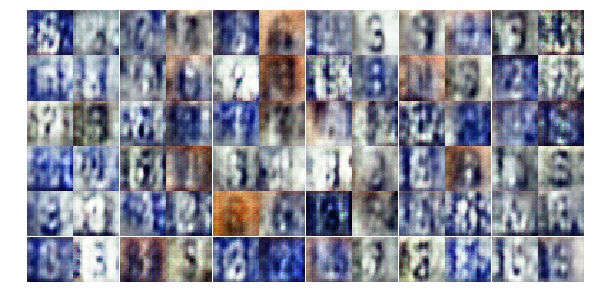

Epoch 1/10... Discriminator Loss: 1.3619... Generator Loss: 0.7097
Epoch 1/10... Discriminator Loss: 1.3531... Generator Loss: 0.6877
Epoch 1/10... Discriminator Loss: 1.3158... Generator Loss: 0.7130
Epoch 1/10... Discriminator Loss: 1.3252... Generator Loss: 0.7108
Epoch 1/10... Discriminator Loss: 1.3489... Generator Loss: 0.7021
Epoch 1/10... Discriminator Loss: 1.4031... Generator Loss: 0.6896
Epoch 1/10... Discriminator Loss: 1.3624... Generator Loss: 0.6874
Epoch 1/10... Discriminator Loss: 1.3542... Generator Loss: 0.7165
Epoch 1/10... Discriminator Loss: 1.3365... Generator Loss: 0.7114
Epoch 1/10... Discriminator Loss: 1.3607... Generator Loss: 0.7140


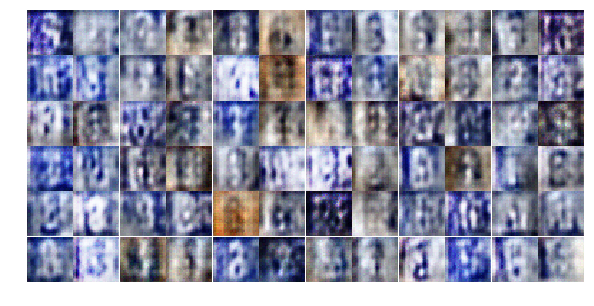

Epoch 1/10... Discriminator Loss: 1.3500... Generator Loss: 0.7129
Epoch 1/10... Discriminator Loss: 1.3486... Generator Loss: 0.6945
Epoch 1/10... Discriminator Loss: 1.3413... Generator Loss: 0.7083
Epoch 1/10... Discriminator Loss: 1.3420... Generator Loss: 0.6836
Epoch 1/10... Discriminator Loss: 1.3360... Generator Loss: 0.7417
Epoch 1/10... Discriminator Loss: 1.2894... Generator Loss: 0.7318
Epoch 1/10... Discriminator Loss: 1.3661... Generator Loss: 0.6300
Epoch 1/10... Discriminator Loss: 1.3622... Generator Loss: 0.7408
Epoch 1/10... Discriminator Loss: 1.3141... Generator Loss: 0.6969
Epoch 1/10... Discriminator Loss: 1.3000... Generator Loss: 0.7271


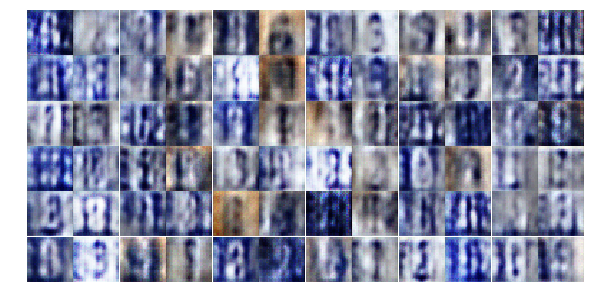

Epoch 1/10... Discriminator Loss: 1.3141... Generator Loss: 0.7670
Epoch 1/10... Discriminator Loss: 1.3168... Generator Loss: 0.7990
Epoch 1/10... Discriminator Loss: 1.3604... Generator Loss: 0.6929
Epoch 1/10... Discriminator Loss: 1.3473... Generator Loss: 0.7029
Epoch 1/10... Discriminator Loss: 1.3143... Generator Loss: 0.7438
Epoch 1/10... Discriminator Loss: 1.2516... Generator Loss: 0.8843
Epoch 1/10... Discriminator Loss: 1.3280... Generator Loss: 0.7146
Epoch 1/10... Discriminator Loss: 1.3181... Generator Loss: 0.7440
Epoch 1/10... Discriminator Loss: 1.2486... Generator Loss: 0.8608
Epoch 1/10... Discriminator Loss: 1.3462... Generator Loss: 0.6945


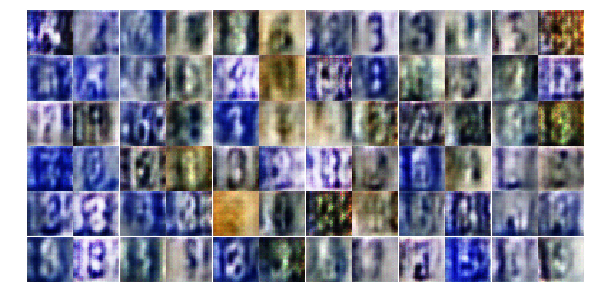

Epoch 1/10... Discriminator Loss: 1.3537... Generator Loss: 0.7375
Epoch 1/10... Discriminator Loss: 1.3408... Generator Loss: 0.6949
Epoch 1/10... Discriminator Loss: 1.3106... Generator Loss: 0.6379
Epoch 1/10... Discriminator Loss: 1.3100... Generator Loss: 0.8759
Epoch 1/10... Discriminator Loss: 1.2829... Generator Loss: 0.6490
Epoch 1/10... Discriminator Loss: 1.2649... Generator Loss: 0.7922
Epoch 1/10... Discriminator Loss: 1.2455... Generator Loss: 0.7505
Epoch 1/10... Discriminator Loss: 1.2876... Generator Loss: 0.7731
Epoch 1/10... Discriminator Loss: 1.3322... Generator Loss: 0.8118
Epoch 1/10... Discriminator Loss: 1.2672... Generator Loss: 0.6293


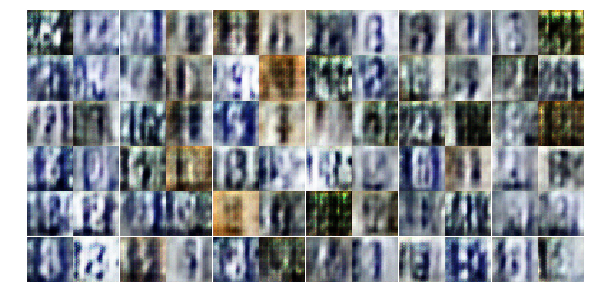

Epoch 1/10... Discriminator Loss: 1.3900... Generator Loss: 0.4819
Epoch 1/10... Discriminator Loss: 1.3293... Generator Loss: 0.5192
Epoch 1/10... Discriminator Loss: 1.2893... Generator Loss: 0.8365
Epoch 1/10... Discriminator Loss: 1.3091... Generator Loss: 0.6166
Epoch 2/10... Discriminator Loss: 1.3003... Generator Loss: 0.7431
Epoch 2/10... Discriminator Loss: 1.3534... Generator Loss: 0.5703
Epoch 2/10... Discriminator Loss: 1.2932... Generator Loss: 0.7145
Epoch 2/10... Discriminator Loss: 1.2474... Generator Loss: 0.8443
Epoch 2/10... Discriminator Loss: 1.3604... Generator Loss: 0.5991
Epoch 2/10... Discriminator Loss: 1.2039... Generator Loss: 0.8965


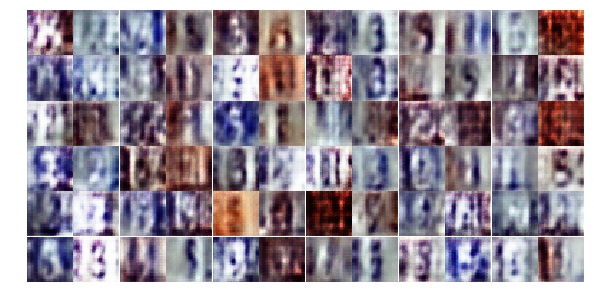

Epoch 2/10... Discriminator Loss: 1.1635... Generator Loss: 0.7459
Epoch 2/10... Discriminator Loss: 1.2375... Generator Loss: 0.7083
Epoch 2/10... Discriminator Loss: 1.2480... Generator Loss: 0.5489
Epoch 2/10... Discriminator Loss: 1.1970... Generator Loss: 0.9493
Epoch 2/10... Discriminator Loss: 1.1835... Generator Loss: 0.7242
Epoch 2/10... Discriminator Loss: 1.3552... Generator Loss: 0.6258
Epoch 2/10... Discriminator Loss: 1.3120... Generator Loss: 0.5840
Epoch 2/10... Discriminator Loss: 1.1251... Generator Loss: 0.6415
Epoch 2/10... Discriminator Loss: 1.1886... Generator Loss: 0.6518
Epoch 2/10... Discriminator Loss: 1.2806... Generator Loss: 0.6772


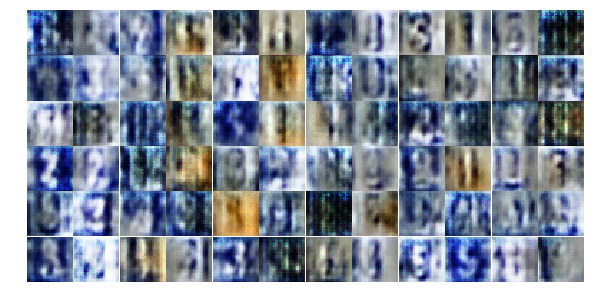

Epoch 2/10... Discriminator Loss: 1.0522... Generator Loss: 0.9393
Epoch 2/10... Discriminator Loss: 1.1879... Generator Loss: 0.8317
Epoch 2/10... Discriminator Loss: 1.2234... Generator Loss: 0.6506
Epoch 2/10... Discriminator Loss: 1.2353... Generator Loss: 0.6549
Epoch 2/10... Discriminator Loss: 1.1638... Generator Loss: 0.9013
Epoch 2/10... Discriminator Loss: 1.2114... Generator Loss: 0.9471
Epoch 2/10... Discriminator Loss: 1.3423... Generator Loss: 0.5660
Epoch 2/10... Discriminator Loss: 1.2754... Generator Loss: 0.4516
Epoch 2/10... Discriminator Loss: 1.2410... Generator Loss: 0.7224
Epoch 2/10... Discriminator Loss: 1.3665... Generator Loss: 0.5863


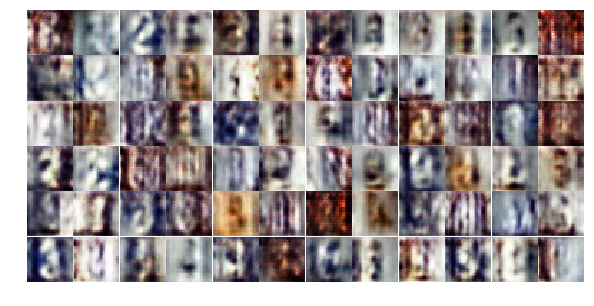

Epoch 2/10... Discriminator Loss: 1.3426... Generator Loss: 0.6425
Epoch 2/10... Discriminator Loss: 1.2531... Generator Loss: 0.5931
Epoch 2/10... Discriminator Loss: 1.1957... Generator Loss: 0.8778
Epoch 2/10... Discriminator Loss: 1.2643... Generator Loss: 0.5908
Epoch 2/10... Discriminator Loss: 1.1452... Generator Loss: 0.8432
Epoch 2/10... Discriminator Loss: 1.2427... Generator Loss: 0.7193
Epoch 2/10... Discriminator Loss: 1.2780... Generator Loss: 0.7031
Epoch 2/10... Discriminator Loss: 1.2493... Generator Loss: 0.6780
Epoch 2/10... Discriminator Loss: 1.1357... Generator Loss: 1.0200
Epoch 2/10... Discriminator Loss: 1.1279... Generator Loss: 0.7587


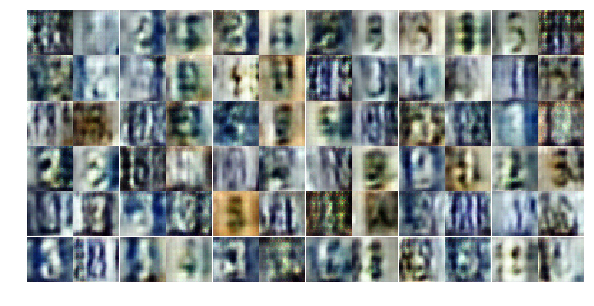

Epoch 2/10... Discriminator Loss: 1.2521... Generator Loss: 0.7528
Epoch 2/10... Discriminator Loss: 1.2998... Generator Loss: 0.6605
Epoch 2/10... Discriminator Loss: 1.2765... Generator Loss: 0.5767
Epoch 2/10... Discriminator Loss: 1.2574... Generator Loss: 0.9559
Epoch 2/10... Discriminator Loss: 1.1611... Generator Loss: 0.9002
Epoch 2/10... Discriminator Loss: 1.1403... Generator Loss: 0.7890
Epoch 2/10... Discriminator Loss: 1.0867... Generator Loss: 0.9024
Epoch 2/10... Discriminator Loss: 1.1063... Generator Loss: 0.8165
Epoch 2/10... Discriminator Loss: 1.1661... Generator Loss: 0.7534
Epoch 2/10... Discriminator Loss: 1.1584... Generator Loss: 0.6962


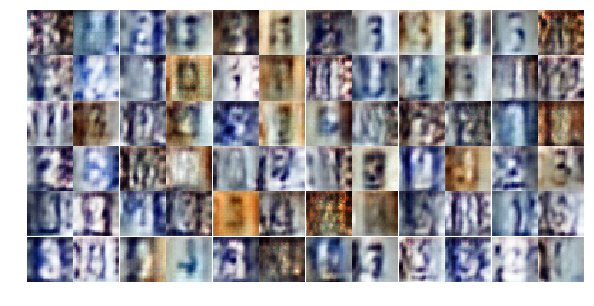

Epoch 2/10... Discriminator Loss: 1.0926... Generator Loss: 0.8580
Epoch 2/10... Discriminator Loss: 1.1404... Generator Loss: 0.6502
Epoch 2/10... Discriminator Loss: 1.1790... Generator Loss: 0.6845
Epoch 2/10... Discriminator Loss: 1.1027... Generator Loss: 0.9812
Epoch 2/10... Discriminator Loss: 1.0114... Generator Loss: 1.0024
Epoch 2/10... Discriminator Loss: 1.1216... Generator Loss: 0.7534
Epoch 2/10... Discriminator Loss: 1.2554... Generator Loss: 0.5525
Epoch 2/10... Discriminator Loss: 1.0435... Generator Loss: 0.8338
Epoch 2/10... Discriminator Loss: 1.0728... Generator Loss: 1.0560
Epoch 2/10... Discriminator Loss: 1.1809... Generator Loss: 0.7195


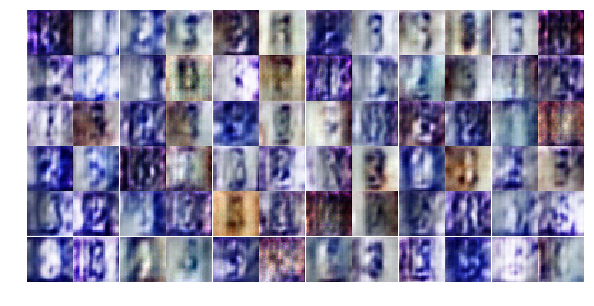

Epoch 2/10... Discriminator Loss: 1.0411... Generator Loss: 0.8173
Epoch 2/10... Discriminator Loss: 1.1603... Generator Loss: 0.9205
Epoch 2/10... Discriminator Loss: 1.1725... Generator Loss: 0.5423
Epoch 2/10... Discriminator Loss: 1.2770... Generator Loss: 0.6591
Epoch 2/10... Discriminator Loss: 1.1350... Generator Loss: 0.8230
Epoch 2/10... Discriminator Loss: 1.2418... Generator Loss: 0.7414
Epoch 2/10... Discriminator Loss: 1.2499... Generator Loss: 1.2863
Epoch 2/10... Discriminator Loss: 1.2032... Generator Loss: 0.9058
Epoch 2/10... Discriminator Loss: 0.9569... Generator Loss: 1.2812
Epoch 2/10... Discriminator Loss: 1.0806... Generator Loss: 0.7560


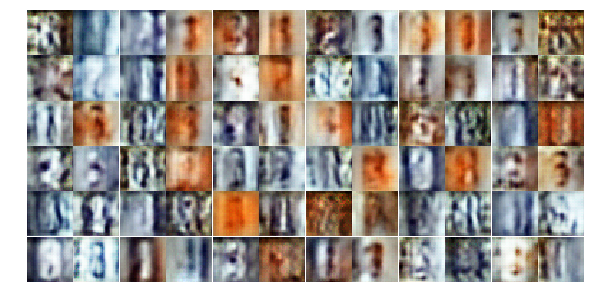

Epoch 2/10... Discriminator Loss: 1.2945... Generator Loss: 0.4458
Epoch 2/10... Discriminator Loss: 1.3545... Generator Loss: 0.5002
Epoch 2/10... Discriminator Loss: 1.1639... Generator Loss: 0.6547
Epoch 2/10... Discriminator Loss: 1.0429... Generator Loss: 0.9507
Epoch 2/10... Discriminator Loss: 0.9546... Generator Loss: 1.0283
Epoch 2/10... Discriminator Loss: 0.9106... Generator Loss: 1.0898
Epoch 2/10... Discriminator Loss: 1.0883... Generator Loss: 0.6807
Epoch 2/10... Discriminator Loss: 1.1281... Generator Loss: 0.5933
Epoch 2/10... Discriminator Loss: 0.8488... Generator Loss: 0.9176
Epoch 2/10... Discriminator Loss: 0.9893... Generator Loss: 0.8454


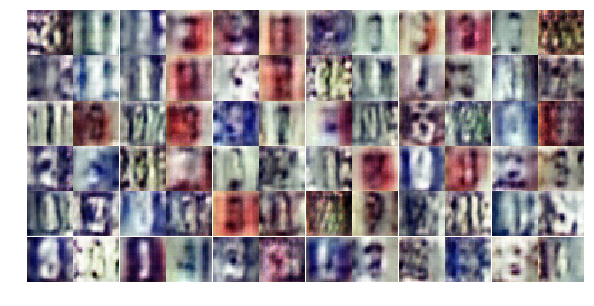

Epoch 2/10... Discriminator Loss: 1.1247... Generator Loss: 0.6695
Epoch 2/10... Discriminator Loss: 1.0440... Generator Loss: 0.8257
Epoch 2/10... Discriminator Loss: 1.0866... Generator Loss: 0.8631
Epoch 2/10... Discriminator Loss: 1.1946... Generator Loss: 0.6324
Epoch 2/10... Discriminator Loss: 1.0839... Generator Loss: 0.6876
Epoch 2/10... Discriminator Loss: 1.1756... Generator Loss: 0.6416
Epoch 2/10... Discriminator Loss: 1.0263... Generator Loss: 0.7293
Epoch 2/10... Discriminator Loss: 1.1182... Generator Loss: 0.6154
Epoch 2/10... Discriminator Loss: 1.0592... Generator Loss: 0.7033
Epoch 2/10... Discriminator Loss: 0.7987... Generator Loss: 0.8960


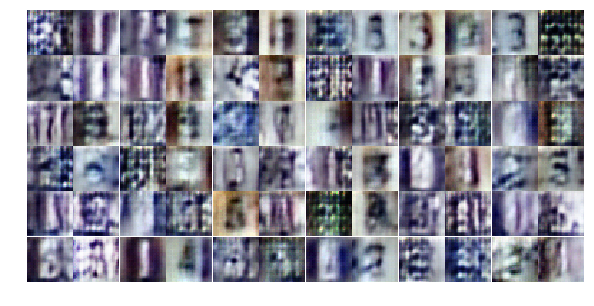

Epoch 2/10... Discriminator Loss: 0.8459... Generator Loss: 0.8825
Epoch 2/10... Discriminator Loss: 1.2016... Generator Loss: 0.5481
Epoch 2/10... Discriminator Loss: 1.0127... Generator Loss: 0.8755
Epoch 2/10... Discriminator Loss: 0.9968... Generator Loss: 0.9965
Epoch 2/10... Discriminator Loss: 1.1581... Generator Loss: 0.6202
Epoch 2/10... Discriminator Loss: 0.9318... Generator Loss: 0.8760
Epoch 2/10... Discriminator Loss: 1.1273... Generator Loss: 0.7208
Epoch 2/10... Discriminator Loss: 1.2959... Generator Loss: 0.5174
Epoch 2/10... Discriminator Loss: 0.9438... Generator Loss: 0.9136
Epoch 2/10... Discriminator Loss: 0.9477... Generator Loss: 0.8196


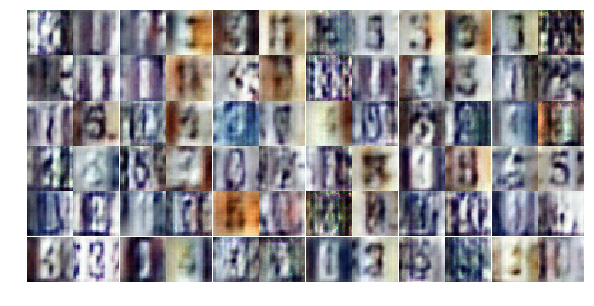

Epoch 2/10... Discriminator Loss: 1.0659... Generator Loss: 0.9802
Epoch 2/10... Discriminator Loss: 0.9338... Generator Loss: 0.8964
Epoch 2/10... Discriminator Loss: 0.9032... Generator Loss: 1.1706
Epoch 2/10... Discriminator Loss: 1.1184... Generator Loss: 0.5014
Epoch 2/10... Discriminator Loss: 1.2087... Generator Loss: 0.5227
Epoch 2/10... Discriminator Loss: 0.9565... Generator Loss: 0.8096
Epoch 2/10... Discriminator Loss: 1.0381... Generator Loss: 0.7192
Epoch 2/10... Discriminator Loss: 1.0873... Generator Loss: 0.6534
Epoch 2/10... Discriminator Loss: 1.2589... Generator Loss: 0.4897
Epoch 2/10... Discriminator Loss: 1.0425... Generator Loss: 0.8424


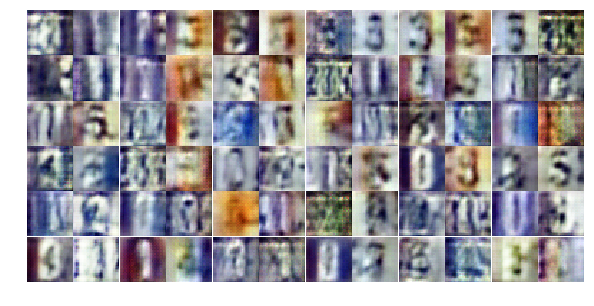

Epoch 2/10... Discriminator Loss: 1.0628... Generator Loss: 0.6813
Epoch 2/10... Discriminator Loss: 0.9701... Generator Loss: 0.8288
Epoch 2/10... Discriminator Loss: 0.9918... Generator Loss: 0.6361
Epoch 2/10... Discriminator Loss: 0.8569... Generator Loss: 0.8001
Epoch 2/10... Discriminator Loss: 1.1349... Generator Loss: 0.8441
Epoch 2/10... Discriminator Loss: 1.0526... Generator Loss: 0.5815
Epoch 2/10... Discriminator Loss: 1.0603... Generator Loss: 1.3127
Epoch 2/10... Discriminator Loss: 0.7572... Generator Loss: 0.8463
Epoch 2/10... Discriminator Loss: 1.0155... Generator Loss: 1.1563
Epoch 3/10... Discriminator Loss: 1.0051... Generator Loss: 0.7920


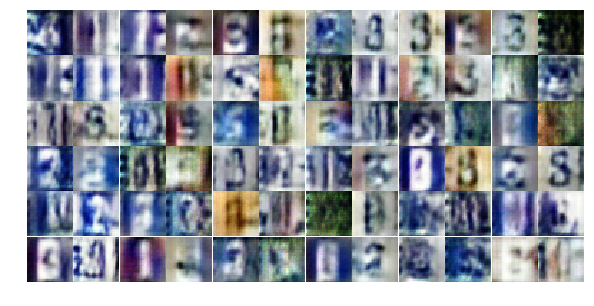

Epoch 3/10... Discriminator Loss: 0.8953... Generator Loss: 0.9673
Epoch 3/10... Discriminator Loss: 0.7687... Generator Loss: 1.0975
Epoch 3/10... Discriminator Loss: 0.9431... Generator Loss: 2.0335
Epoch 3/10... Discriminator Loss: 0.8696... Generator Loss: 1.1592
Epoch 3/10... Discriminator Loss: 0.9519... Generator Loss: 1.3330
Epoch 3/10... Discriminator Loss: 0.9986... Generator Loss: 1.0730
Epoch 3/10... Discriminator Loss: 0.8238... Generator Loss: 0.9043
Epoch 3/10... Discriminator Loss: 0.8023... Generator Loss: 0.8206
Epoch 3/10... Discriminator Loss: 1.0850... Generator Loss: 0.7358
Epoch 3/10... Discriminator Loss: 1.1344... Generator Loss: 1.7343


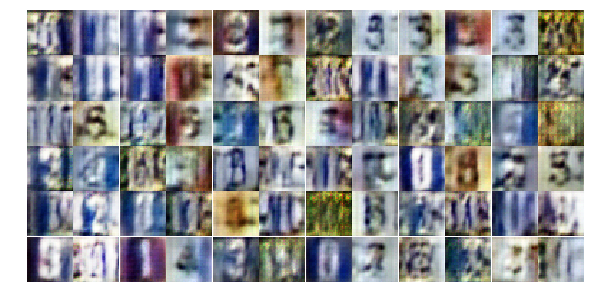

Epoch 3/10... Discriminator Loss: 1.2492... Generator Loss: 0.4525
Epoch 3/10... Discriminator Loss: 1.1035... Generator Loss: 0.6121
Epoch 3/10... Discriminator Loss: 0.9447... Generator Loss: 0.6564
Epoch 3/10... Discriminator Loss: 0.8900... Generator Loss: 0.8900
Epoch 3/10... Discriminator Loss: 0.6975... Generator Loss: 0.9428
Epoch 3/10... Discriminator Loss: 1.8395... Generator Loss: 2.7124
Epoch 3/10... Discriminator Loss: 0.9701... Generator Loss: 0.9089
Epoch 3/10... Discriminator Loss: 1.0582... Generator Loss: 0.6842
Epoch 3/10... Discriminator Loss: 0.8439... Generator Loss: 0.8568
Epoch 3/10... Discriminator Loss: 0.9845... Generator Loss: 0.6707


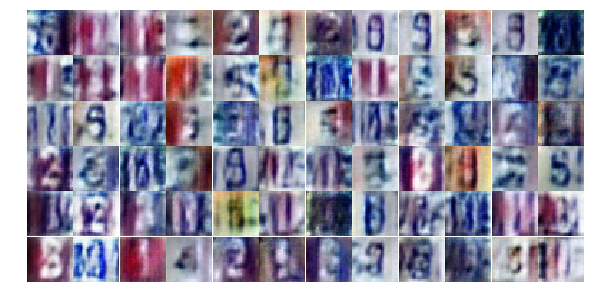

Epoch 3/10... Discriminator Loss: 0.9552... Generator Loss: 1.0974
Epoch 3/10... Discriminator Loss: 1.2106... Generator Loss: 0.5045
Epoch 3/10... Discriminator Loss: 0.8962... Generator Loss: 0.9311
Epoch 3/10... Discriminator Loss: 0.8562... Generator Loss: 0.8424
Epoch 3/10... Discriminator Loss: 1.3165... Generator Loss: 0.3919
Epoch 3/10... Discriminator Loss: 1.1948... Generator Loss: 0.6166
Epoch 3/10... Discriminator Loss: 0.9080... Generator Loss: 1.0344
Epoch 3/10... Discriminator Loss: 1.1729... Generator Loss: 0.6061
Epoch 3/10... Discriminator Loss: 0.9408... Generator Loss: 0.6414
Epoch 3/10... Discriminator Loss: 0.9063... Generator Loss: 0.9421


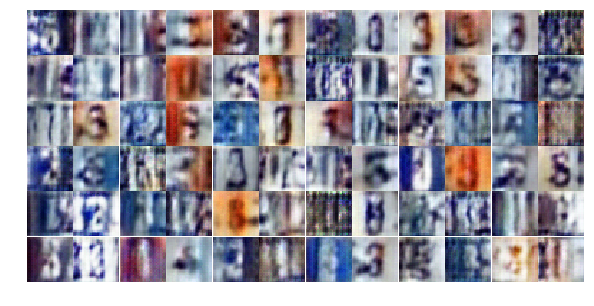

Epoch 3/10... Discriminator Loss: 0.8379... Generator Loss: 1.1655
Epoch 3/10... Discriminator Loss: 0.8280... Generator Loss: 1.3981
Epoch 3/10... Discriminator Loss: 1.4028... Generator Loss: 0.3748
Epoch 3/10... Discriminator Loss: 0.8707... Generator Loss: 1.0617
Epoch 3/10... Discriminator Loss: 1.0492... Generator Loss: 0.6432
Epoch 3/10... Discriminator Loss: 0.8434... Generator Loss: 1.1676
Epoch 3/10... Discriminator Loss: 0.8328... Generator Loss: 1.0913
Epoch 3/10... Discriminator Loss: 0.9591... Generator Loss: 1.6136
Epoch 3/10... Discriminator Loss: 0.8990... Generator Loss: 1.4197
Epoch 3/10... Discriminator Loss: 1.1506... Generator Loss: 0.5400


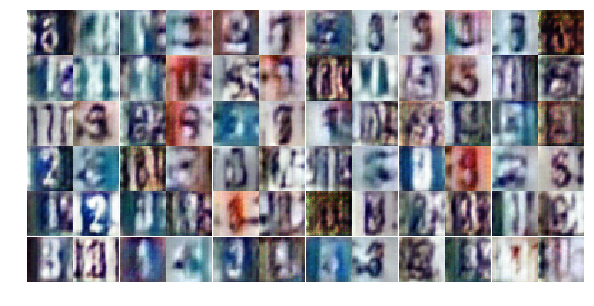

Epoch 3/10... Discriminator Loss: 0.9818... Generator Loss: 0.6120
Epoch 3/10... Discriminator Loss: 0.9610... Generator Loss: 0.7661
Epoch 3/10... Discriminator Loss: 0.7539... Generator Loss: 0.9851
Epoch 3/10... Discriminator Loss: 0.8689... Generator Loss: 0.9467
Epoch 3/10... Discriminator Loss: 0.7666... Generator Loss: 1.1927
Epoch 3/10... Discriminator Loss: 1.4681... Generator Loss: 0.3170
Epoch 3/10... Discriminator Loss: 1.1792... Generator Loss: 1.2698
Epoch 3/10... Discriminator Loss: 0.7792... Generator Loss: 0.9807
Epoch 3/10... Discriminator Loss: 1.0679... Generator Loss: 0.6327
Epoch 3/10... Discriminator Loss: 1.0745... Generator Loss: 1.0264


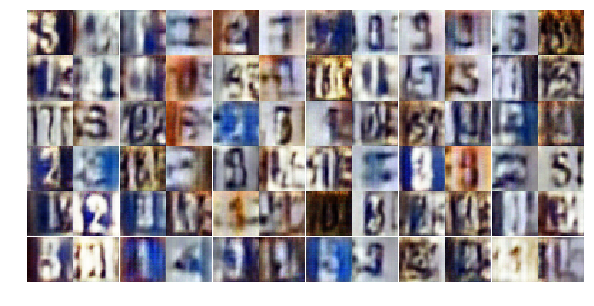

Epoch 3/10... Discriminator Loss: 0.9965... Generator Loss: 0.6394
Epoch 3/10... Discriminator Loss: 1.3060... Generator Loss: 0.5273
Epoch 3/10... Discriminator Loss: 1.0343... Generator Loss: 0.6937
Epoch 3/10... Discriminator Loss: 0.9620... Generator Loss: 0.6953
Epoch 3/10... Discriminator Loss: 1.0822... Generator Loss: 0.5444
Epoch 3/10... Discriminator Loss: 0.9362... Generator Loss: 1.4091
Epoch 3/10... Discriminator Loss: 0.9717... Generator Loss: 0.9193
Epoch 3/10... Discriminator Loss: 1.1744... Generator Loss: 1.3757
Epoch 3/10... Discriminator Loss: 0.8908... Generator Loss: 1.0102
Epoch 3/10... Discriminator Loss: 0.8411... Generator Loss: 1.0121


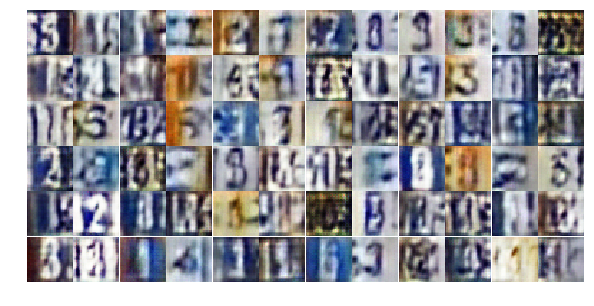

Epoch 3/10... Discriminator Loss: 0.7842... Generator Loss: 1.1077
Epoch 3/10... Discriminator Loss: 0.9202... Generator Loss: 0.7701
Epoch 3/10... Discriminator Loss: 0.9743... Generator Loss: 0.7456
Epoch 3/10... Discriminator Loss: 0.9047... Generator Loss: 0.8054
Epoch 3/10... Discriminator Loss: 0.7373... Generator Loss: 1.2020
Epoch 3/10... Discriminator Loss: 1.1599... Generator Loss: 0.4943
Epoch 3/10... Discriminator Loss: 0.9763... Generator Loss: 1.0700
Epoch 3/10... Discriminator Loss: 1.1933... Generator Loss: 0.7483
Epoch 3/10... Discriminator Loss: 0.8841... Generator Loss: 0.9933
Epoch 3/10... Discriminator Loss: 1.0812... Generator Loss: 0.7362


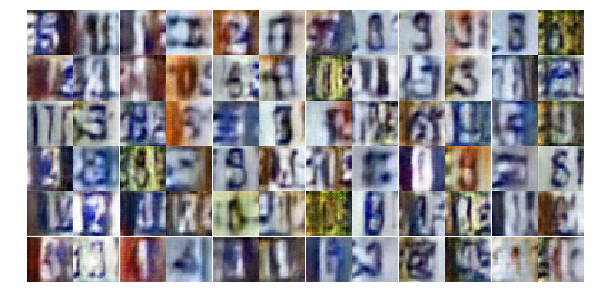

Epoch 3/10... Discriminator Loss: 1.0187... Generator Loss: 0.7849
Epoch 3/10... Discriminator Loss: 1.4162... Generator Loss: 0.4953
Epoch 3/10... Discriminator Loss: 0.9656... Generator Loss: 1.0499
Epoch 3/10... Discriminator Loss: 0.9461... Generator Loss: 0.8156
Epoch 3/10... Discriminator Loss: 1.0516... Generator Loss: 0.7881
Epoch 3/10... Discriminator Loss: 1.2845... Generator Loss: 0.4619
Epoch 3/10... Discriminator Loss: 0.8795... Generator Loss: 0.9716
Epoch 3/10... Discriminator Loss: 1.1635... Generator Loss: 0.5733
Epoch 3/10... Discriminator Loss: 0.9746... Generator Loss: 0.8183
Epoch 3/10... Discriminator Loss: 0.8270... Generator Loss: 1.0522


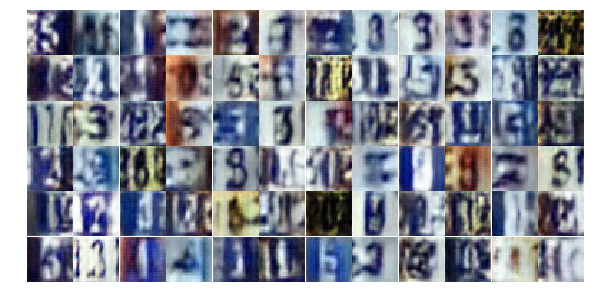

Epoch 3/10... Discriminator Loss: 1.0643... Generator Loss: 1.1427
Epoch 3/10... Discriminator Loss: 0.9689... Generator Loss: 0.8065
Epoch 3/10... Discriminator Loss: 1.0099... Generator Loss: 0.6270
Epoch 3/10... Discriminator Loss: 1.1017... Generator Loss: 0.7105
Epoch 3/10... Discriminator Loss: 0.9718... Generator Loss: 1.7727
Epoch 3/10... Discriminator Loss: 1.1361... Generator Loss: 0.5975
Epoch 3/10... Discriminator Loss: 0.7653... Generator Loss: 1.4294
Epoch 3/10... Discriminator Loss: 1.4890... Generator Loss: 0.3665
Epoch 3/10... Discriminator Loss: 1.1463... Generator Loss: 0.6447
Epoch 3/10... Discriminator Loss: 1.0515... Generator Loss: 0.8545


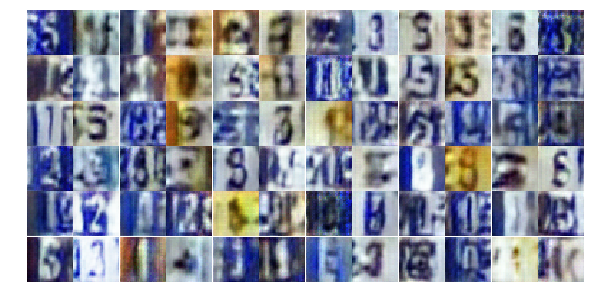

Epoch 3/10... Discriminator Loss: 1.0266... Generator Loss: 0.8862
Epoch 3/10... Discriminator Loss: 1.2439... Generator Loss: 0.4459
Epoch 3/10... Discriminator Loss: 0.8625... Generator Loss: 1.2248
Epoch 3/10... Discriminator Loss: 0.7923... Generator Loss: 1.0189
Epoch 3/10... Discriminator Loss: 1.0410... Generator Loss: 0.8751
Epoch 3/10... Discriminator Loss: 0.7917... Generator Loss: 1.1248
Epoch 3/10... Discriminator Loss: 0.7791... Generator Loss: 0.9772
Epoch 3/10... Discriminator Loss: 0.9657... Generator Loss: 0.9391
Epoch 3/10... Discriminator Loss: 1.1010... Generator Loss: 0.6741
Epoch 3/10... Discriminator Loss: 1.0030... Generator Loss: 0.9562


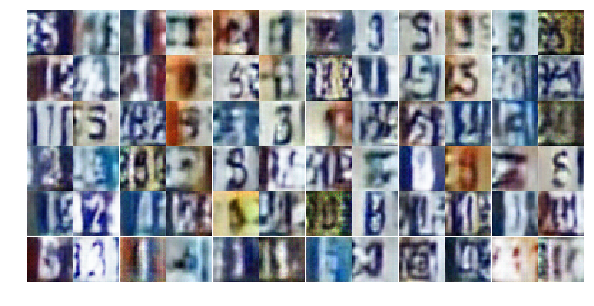

Epoch 3/10... Discriminator Loss: 0.8277... Generator Loss: 1.0475
Epoch 3/10... Discriminator Loss: 0.8979... Generator Loss: 1.2374
Epoch 3/10... Discriminator Loss: 1.2090... Generator Loss: 1.3225
Epoch 3/10... Discriminator Loss: 0.9234... Generator Loss: 0.8937
Epoch 3/10... Discriminator Loss: 0.6633... Generator Loss: 1.5236
Epoch 3/10... Discriminator Loss: 1.4988... Generator Loss: 0.4644
Epoch 3/10... Discriminator Loss: 0.9557... Generator Loss: 0.9160
Epoch 3/10... Discriminator Loss: 1.1524... Generator Loss: 0.5292
Epoch 3/10... Discriminator Loss: 0.9765... Generator Loss: 0.7355
Epoch 3/10... Discriminator Loss: 1.0041... Generator Loss: 0.6331


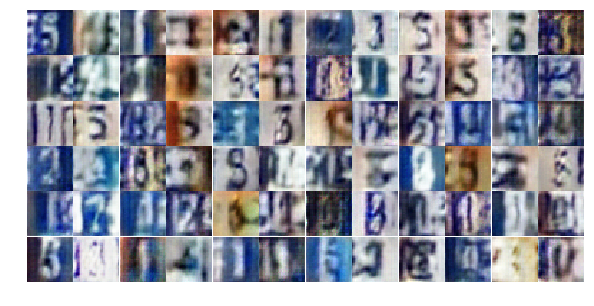

Epoch 3/10... Discriminator Loss: 1.0036... Generator Loss: 0.8065
Epoch 3/10... Discriminator Loss: 1.0070... Generator Loss: 0.8363
Epoch 3/10... Discriminator Loss: 0.8970... Generator Loss: 1.2819
Epoch 4/10... Discriminator Loss: 1.0262... Generator Loss: 0.8947
Epoch 4/10... Discriminator Loss: 0.9212... Generator Loss: 0.9934
Epoch 4/10... Discriminator Loss: 0.8028... Generator Loss: 1.0458
Epoch 4/10... Discriminator Loss: 0.9418... Generator Loss: 1.0068
Epoch 4/10... Discriminator Loss: 0.9346... Generator Loss: 0.9395
Epoch 4/10... Discriminator Loss: 0.8558... Generator Loss: 0.8867
Epoch 4/10... Discriminator Loss: 1.0583... Generator Loss: 0.8213


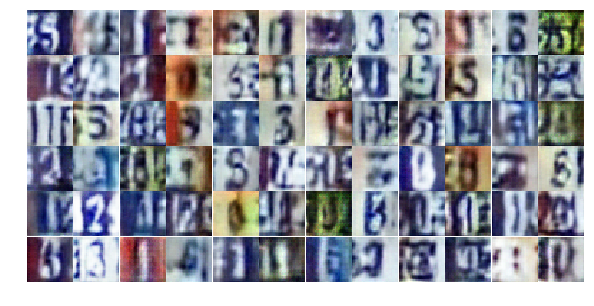

Epoch 4/10... Discriminator Loss: 0.9663... Generator Loss: 0.8728
Epoch 4/10... Discriminator Loss: 1.1851... Generator Loss: 0.6523
Epoch 4/10... Discriminator Loss: 0.8789... Generator Loss: 0.8097
Epoch 4/10... Discriminator Loss: 1.0203... Generator Loss: 0.6515
Epoch 4/10... Discriminator Loss: 0.7543... Generator Loss: 1.1680
Epoch 4/10... Discriminator Loss: 0.9506... Generator Loss: 0.7754
Epoch 4/10... Discriminator Loss: 0.9984... Generator Loss: 0.7179
Epoch 4/10... Discriminator Loss: 0.9062... Generator Loss: 0.9660
Epoch 4/10... Discriminator Loss: 0.9896... Generator Loss: 0.8541
Epoch 4/10... Discriminator Loss: 0.7334... Generator Loss: 1.6933


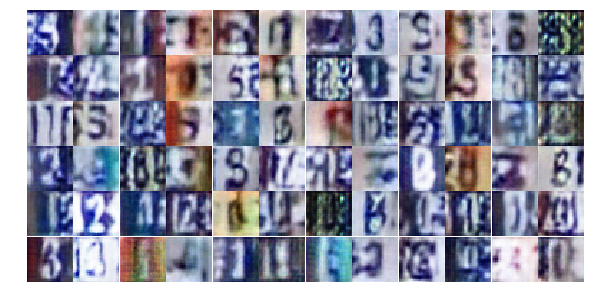

Epoch 4/10... Discriminator Loss: 1.0381... Generator Loss: 0.7801
Epoch 4/10... Discriminator Loss: 1.2435... Generator Loss: 1.1359
Epoch 4/10... Discriminator Loss: 1.1423... Generator Loss: 0.6192
Epoch 4/10... Discriminator Loss: 1.1492... Generator Loss: 0.7392
Epoch 4/10... Discriminator Loss: 0.8673... Generator Loss: 0.8151
Epoch 4/10... Discriminator Loss: 0.8194... Generator Loss: 1.2162
Epoch 4/10... Discriminator Loss: 1.0027... Generator Loss: 0.9231
Epoch 4/10... Discriminator Loss: 0.9871... Generator Loss: 0.7524
Epoch 4/10... Discriminator Loss: 0.9905... Generator Loss: 0.7819
Epoch 4/10... Discriminator Loss: 1.1700... Generator Loss: 0.5823


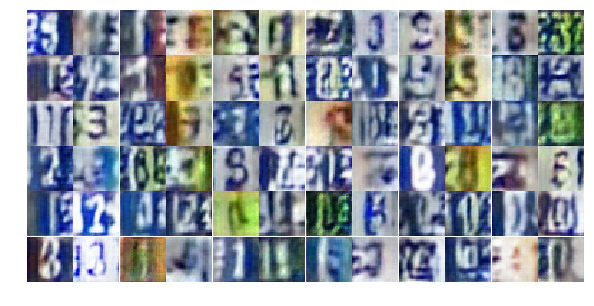

Epoch 4/10... Discriminator Loss: 0.9706... Generator Loss: 0.7321
Epoch 4/10... Discriminator Loss: 1.0442... Generator Loss: 1.2794
Epoch 4/10... Discriminator Loss: 1.1841... Generator Loss: 0.5574
Epoch 4/10... Discriminator Loss: 1.0724... Generator Loss: 0.7617
Epoch 4/10... Discriminator Loss: 1.0701... Generator Loss: 0.7564
Epoch 4/10... Discriminator Loss: 1.0503... Generator Loss: 0.9054
Epoch 4/10... Discriminator Loss: 1.0497... Generator Loss: 0.7132
Epoch 4/10... Discriminator Loss: 0.7533... Generator Loss: 1.2846
Epoch 4/10... Discriminator Loss: 1.0265... Generator Loss: 0.6400
Epoch 4/10... Discriminator Loss: 1.2711... Generator Loss: 0.5007


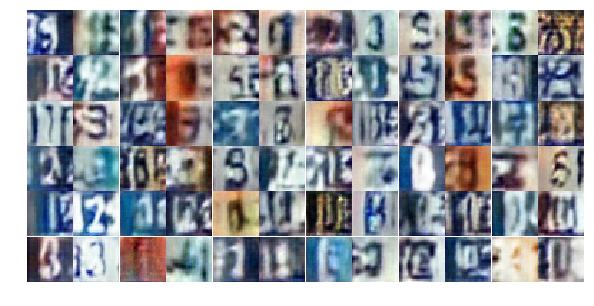

Epoch 4/10... Discriminator Loss: 1.2007... Generator Loss: 0.5486
Epoch 4/10... Discriminator Loss: 1.0508... Generator Loss: 0.6119
Epoch 4/10... Discriminator Loss: 0.8393... Generator Loss: 1.3102
Epoch 4/10... Discriminator Loss: 0.7490... Generator Loss: 1.0435
Epoch 4/10... Discriminator Loss: 1.1499... Generator Loss: 0.6096
Epoch 4/10... Discriminator Loss: 1.1818... Generator Loss: 0.4822
Epoch 4/10... Discriminator Loss: 1.0815... Generator Loss: 0.5558
Epoch 4/10... Discriminator Loss: 1.0356... Generator Loss: 0.6713
Epoch 4/10... Discriminator Loss: 1.1527... Generator Loss: 0.5735
Epoch 4/10... Discriminator Loss: 1.1444... Generator Loss: 0.5531


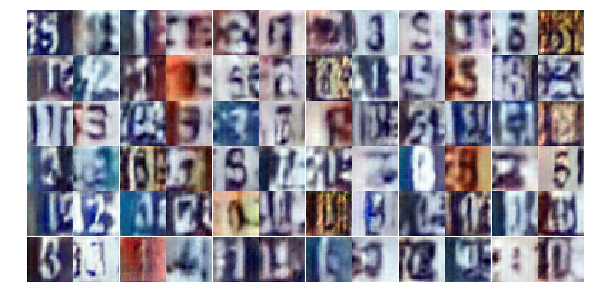

Epoch 4/10... Discriminator Loss: 0.9783... Generator Loss: 0.6234
Epoch 4/10... Discriminator Loss: 0.7564... Generator Loss: 1.0718
Epoch 4/10... Discriminator Loss: 1.1875... Generator Loss: 0.5178
Epoch 4/10... Discriminator Loss: 0.7910... Generator Loss: 0.9009
Epoch 4/10... Discriminator Loss: 0.9314... Generator Loss: 0.7740
Epoch 4/10... Discriminator Loss: 0.9487... Generator Loss: 1.0751
Epoch 4/10... Discriminator Loss: 0.7748... Generator Loss: 1.0669
Epoch 4/10... Discriminator Loss: 0.8495... Generator Loss: 0.9419
Epoch 4/10... Discriminator Loss: 1.1749... Generator Loss: 0.6370
Epoch 4/10... Discriminator Loss: 1.0184... Generator Loss: 0.7530


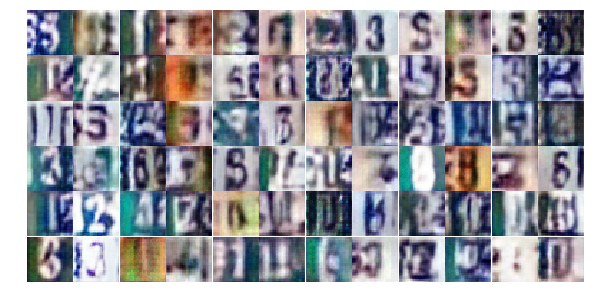

Epoch 4/10... Discriminator Loss: 0.8885... Generator Loss: 1.5738
Epoch 4/10... Discriminator Loss: 1.1018... Generator Loss: 0.5228
Epoch 4/10... Discriminator Loss: 0.9784... Generator Loss: 0.6430
Epoch 4/10... Discriminator Loss: 0.7278... Generator Loss: 1.1152
Epoch 4/10... Discriminator Loss: 0.8277... Generator Loss: 1.0489
Epoch 4/10... Discriminator Loss: 0.8678... Generator Loss: 0.9425
Epoch 4/10... Discriminator Loss: 1.0771... Generator Loss: 0.7171
Epoch 4/10... Discriminator Loss: 1.1121... Generator Loss: 0.5567
Epoch 4/10... Discriminator Loss: 0.8182... Generator Loss: 0.9523
Epoch 4/10... Discriminator Loss: 1.0786... Generator Loss: 0.5090


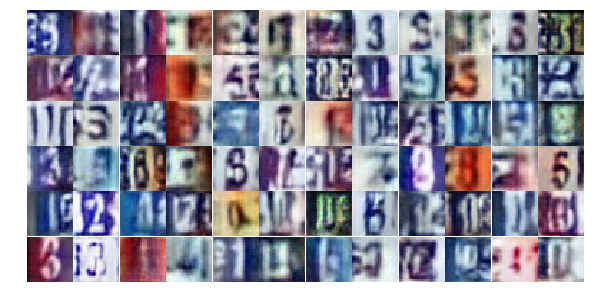

Epoch 4/10... Discriminator Loss: 1.1969... Generator Loss: 0.8656
Epoch 4/10... Discriminator Loss: 1.2042... Generator Loss: 0.4760
Epoch 4/10... Discriminator Loss: 0.8561... Generator Loss: 0.9325
Epoch 4/10... Discriminator Loss: 1.0955... Generator Loss: 0.9211
Epoch 4/10... Discriminator Loss: 1.1707... Generator Loss: 1.1227
Epoch 4/10... Discriminator Loss: 0.9327... Generator Loss: 0.7249
Epoch 4/10... Discriminator Loss: 0.8909... Generator Loss: 1.2110
Epoch 4/10... Discriminator Loss: 0.8553... Generator Loss: 0.9301
Epoch 4/10... Discriminator Loss: 0.7966... Generator Loss: 1.1693
Epoch 4/10... Discriminator Loss: 0.8734... Generator Loss: 0.8958


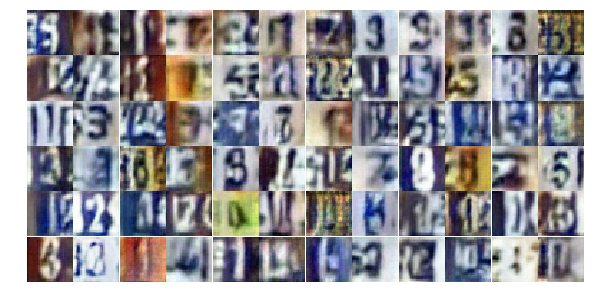

Epoch 4/10... Discriminator Loss: 1.3398... Generator Loss: 0.4296
Epoch 4/10... Discriminator Loss: 0.9613... Generator Loss: 0.7872
Epoch 4/10... Discriminator Loss: 0.8918... Generator Loss: 1.0033
Epoch 4/10... Discriminator Loss: 0.9489... Generator Loss: 0.7129
Epoch 4/10... Discriminator Loss: 0.9772... Generator Loss: 0.8620
Epoch 4/10... Discriminator Loss: 1.0986... Generator Loss: 0.6261
Epoch 4/10... Discriminator Loss: 1.1776... Generator Loss: 0.4787
Epoch 4/10... Discriminator Loss: 1.0809... Generator Loss: 0.5516
Epoch 4/10... Discriminator Loss: 0.8392... Generator Loss: 0.8657
Epoch 4/10... Discriminator Loss: 0.7421... Generator Loss: 1.0983


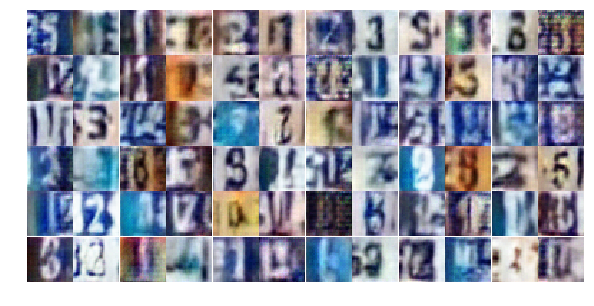

Epoch 4/10... Discriminator Loss: 0.9425... Generator Loss: 0.8762
Epoch 4/10... Discriminator Loss: 1.1679... Generator Loss: 0.4682
Epoch 4/10... Discriminator Loss: 0.9220... Generator Loss: 1.0878
Epoch 4/10... Discriminator Loss: 1.3341... Generator Loss: 0.4140
Epoch 4/10... Discriminator Loss: 0.9463... Generator Loss: 1.2199
Epoch 4/10... Discriminator Loss: 0.8249... Generator Loss: 0.9647
Epoch 4/10... Discriminator Loss: 0.9376... Generator Loss: 0.8749
Epoch 4/10... Discriminator Loss: 1.3168... Generator Loss: 0.4030
Epoch 4/10... Discriminator Loss: 0.9490... Generator Loss: 0.9881
Epoch 4/10... Discriminator Loss: 1.1330... Generator Loss: 0.5936


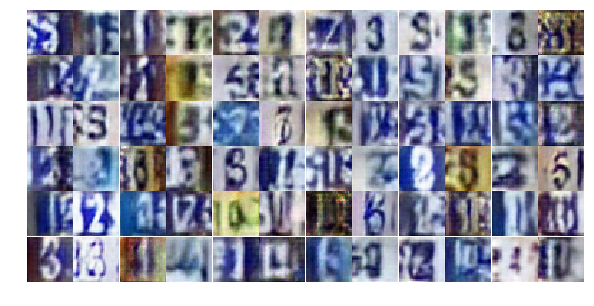

Epoch 4/10... Discriminator Loss: 1.0285... Generator Loss: 0.7350
Epoch 4/10... Discriminator Loss: 0.8209... Generator Loss: 1.3311
Epoch 4/10... Discriminator Loss: 0.7838... Generator Loss: 0.8846
Epoch 4/10... Discriminator Loss: 1.2035... Generator Loss: 0.5556
Epoch 4/10... Discriminator Loss: 1.0355... Generator Loss: 0.6248
Epoch 4/10... Discriminator Loss: 1.1838... Generator Loss: 0.6720
Epoch 4/10... Discriminator Loss: 1.0264... Generator Loss: 0.7120
Epoch 4/10... Discriminator Loss: 1.0253... Generator Loss: 0.6010
Epoch 4/10... Discriminator Loss: 0.6078... Generator Loss: 1.4169
Epoch 4/10... Discriminator Loss: 0.9791... Generator Loss: 1.3870


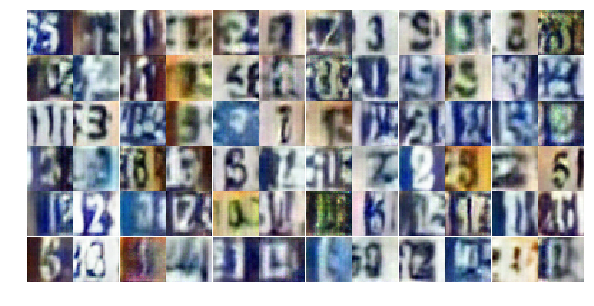

Epoch 4/10... Discriminator Loss: 0.8465... Generator Loss: 1.1610
Epoch 4/10... Discriminator Loss: 0.9739... Generator Loss: 0.8519
Epoch 4/10... Discriminator Loss: 1.0333... Generator Loss: 0.7266
Epoch 4/10... Discriminator Loss: 0.8925... Generator Loss: 0.8499
Epoch 4/10... Discriminator Loss: 1.0994... Generator Loss: 1.6524
Epoch 4/10... Discriminator Loss: 0.9833... Generator Loss: 0.7874
Epoch 4/10... Discriminator Loss: 0.8886... Generator Loss: 0.8486
Epoch 4/10... Discriminator Loss: 1.0049... Generator Loss: 1.0258
Epoch 5/10... Discriminator Loss: 1.3154... Generator Loss: 0.5313
Epoch 5/10... Discriminator Loss: 0.9644... Generator Loss: 1.0006


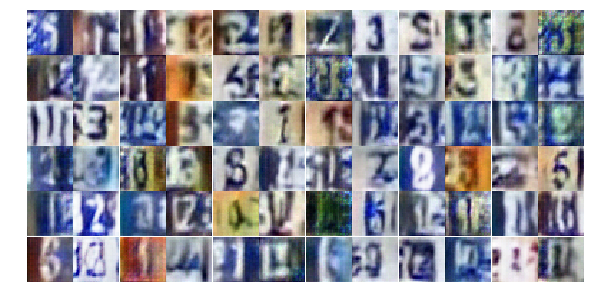

Epoch 5/10... Discriminator Loss: 0.9612... Generator Loss: 1.2654
Epoch 5/10... Discriminator Loss: 0.5935... Generator Loss: 1.2960
Epoch 5/10... Discriminator Loss: 0.7282... Generator Loss: 1.3623
Epoch 5/10... Discriminator Loss: 1.2090... Generator Loss: 1.4409
Epoch 5/10... Discriminator Loss: 1.1276... Generator Loss: 0.5557
Epoch 5/10... Discriminator Loss: 0.8946... Generator Loss: 0.9939
Epoch 5/10... Discriminator Loss: 0.8265... Generator Loss: 0.9870
Epoch 5/10... Discriminator Loss: 1.4653... Generator Loss: 0.3716
Epoch 5/10... Discriminator Loss: 1.1720... Generator Loss: 0.5160
Epoch 5/10... Discriminator Loss: 1.1115... Generator Loss: 0.5952


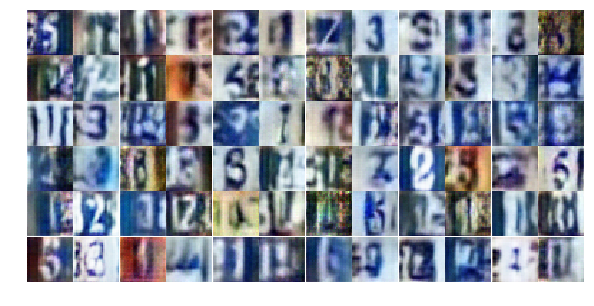

Epoch 5/10... Discriminator Loss: 1.1502... Generator Loss: 0.5114
Epoch 5/10... Discriminator Loss: 0.8516... Generator Loss: 1.3984
Epoch 5/10... Discriminator Loss: 1.2092... Generator Loss: 0.5511
Epoch 5/10... Discriminator Loss: 0.7029... Generator Loss: 0.9042
Epoch 5/10... Discriminator Loss: 0.9245... Generator Loss: 0.8182
Epoch 5/10... Discriminator Loss: 1.0942... Generator Loss: 0.7867
Epoch 5/10... Discriminator Loss: 0.8710... Generator Loss: 0.9561
Epoch 5/10... Discriminator Loss: 0.8553... Generator Loss: 1.3469
Epoch 5/10... Discriminator Loss: 0.7303... Generator Loss: 1.1326
Epoch 5/10... Discriminator Loss: 0.9144... Generator Loss: 0.9970


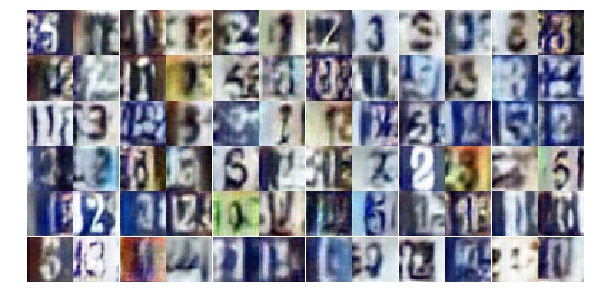

Epoch 5/10... Discriminator Loss: 0.9832... Generator Loss: 1.3042
Epoch 5/10... Discriminator Loss: 0.9127... Generator Loss: 0.9901
Epoch 5/10... Discriminator Loss: 0.8838... Generator Loss: 0.8209
Epoch 5/10... Discriminator Loss: 0.9284... Generator Loss: 0.7121
Epoch 5/10... Discriminator Loss: 0.8546... Generator Loss: 0.8779
Epoch 5/10... Discriminator Loss: 0.9303... Generator Loss: 0.9439
Epoch 5/10... Discriminator Loss: 1.1775... Generator Loss: 0.5588
Epoch 5/10... Discriminator Loss: 0.8533... Generator Loss: 0.7654
Epoch 5/10... Discriminator Loss: 1.0870... Generator Loss: 0.5413
Epoch 5/10... Discriminator Loss: 1.0568... Generator Loss: 0.6581


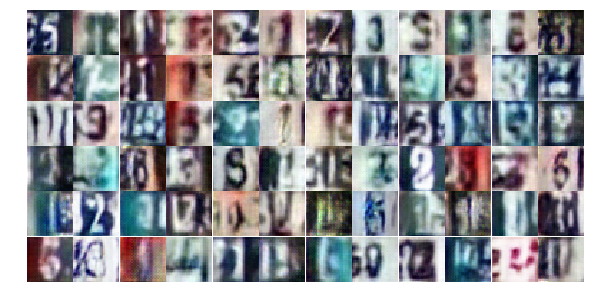

Epoch 5/10... Discriminator Loss: 0.8772... Generator Loss: 0.8682
Epoch 5/10... Discriminator Loss: 1.0883... Generator Loss: 0.5696
Epoch 5/10... Discriminator Loss: 1.2828... Generator Loss: 0.4927
Epoch 5/10... Discriminator Loss: 0.6135... Generator Loss: 1.3172
Epoch 5/10... Discriminator Loss: 0.8283... Generator Loss: 1.0015
Epoch 5/10... Discriminator Loss: 1.0612... Generator Loss: 0.6261
Epoch 5/10... Discriminator Loss: 0.8821... Generator Loss: 1.0890
Epoch 5/10... Discriminator Loss: 1.0806... Generator Loss: 0.5970
Epoch 5/10... Discriminator Loss: 1.0112... Generator Loss: 0.6565
Epoch 5/10... Discriminator Loss: 0.5892... Generator Loss: 1.6871


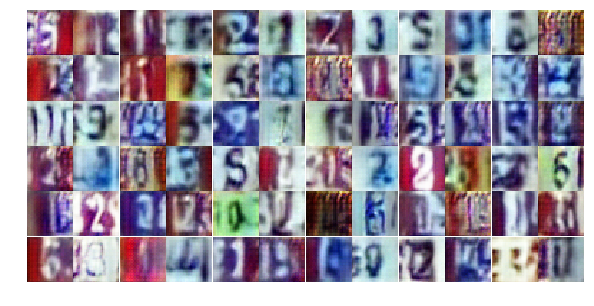

Epoch 5/10... Discriminator Loss: 0.9075... Generator Loss: 1.3569
Epoch 5/10... Discriminator Loss: 0.5290... Generator Loss: 1.2692
Epoch 5/10... Discriminator Loss: 1.0674... Generator Loss: 1.2084
Epoch 5/10... Discriminator Loss: 0.9376... Generator Loss: 0.9761
Epoch 5/10... Discriminator Loss: 1.1149... Generator Loss: 0.6602
Epoch 5/10... Discriminator Loss: 1.0111... Generator Loss: 0.6718
Epoch 5/10... Discriminator Loss: 1.0302... Generator Loss: 0.7123
Epoch 5/10... Discriminator Loss: 1.0801... Generator Loss: 1.7554
Epoch 5/10... Discriminator Loss: 0.9874... Generator Loss: 0.9593
Epoch 5/10... Discriminator Loss: 0.7912... Generator Loss: 0.9488


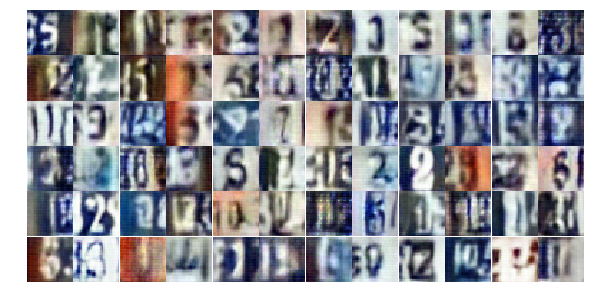

Epoch 5/10... Discriminator Loss: 1.0084... Generator Loss: 0.8048
Epoch 5/10... Discriminator Loss: 1.0929... Generator Loss: 0.6817
Epoch 5/10... Discriminator Loss: 1.0988... Generator Loss: 0.6016
Epoch 5/10... Discriminator Loss: 1.0117... Generator Loss: 0.7615
Epoch 5/10... Discriminator Loss: 1.0904... Generator Loss: 0.5055
Epoch 5/10... Discriminator Loss: 0.9268... Generator Loss: 0.9004
Epoch 5/10... Discriminator Loss: 0.9758... Generator Loss: 0.9666
Epoch 5/10... Discriminator Loss: 0.8187... Generator Loss: 0.9270
Epoch 5/10... Discriminator Loss: 0.8689... Generator Loss: 1.0579
Epoch 5/10... Discriminator Loss: 0.7368... Generator Loss: 0.9491


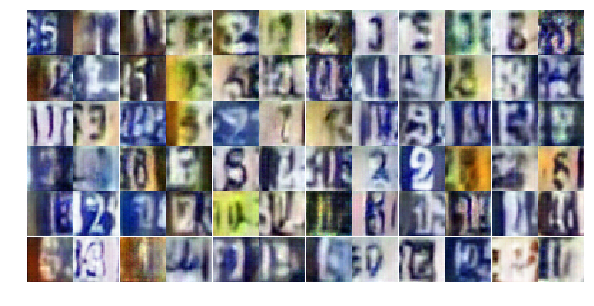

Epoch 5/10... Discriminator Loss: 0.9512... Generator Loss: 0.8475
Epoch 5/10... Discriminator Loss: 0.9449... Generator Loss: 0.9264
Epoch 5/10... Discriminator Loss: 0.9544... Generator Loss: 0.6493
Epoch 5/10... Discriminator Loss: 1.0990... Generator Loss: 1.5706
Epoch 5/10... Discriminator Loss: 1.3389... Generator Loss: 0.3698
Epoch 5/10... Discriminator Loss: 0.9315... Generator Loss: 0.8895
Epoch 5/10... Discriminator Loss: 0.9330... Generator Loss: 0.9221
Epoch 5/10... Discriminator Loss: 1.0265... Generator Loss: 0.6692
Epoch 5/10... Discriminator Loss: 1.1812... Generator Loss: 0.5502
Epoch 5/10... Discriminator Loss: 0.7690... Generator Loss: 1.0385


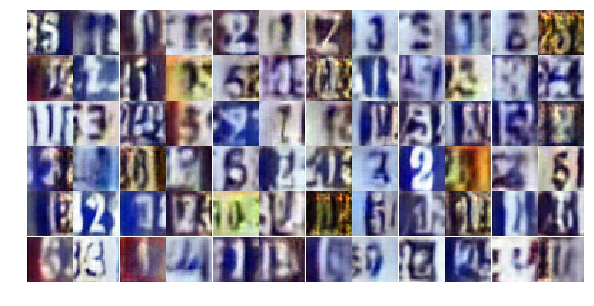

Epoch 5/10... Discriminator Loss: 1.1666... Generator Loss: 0.5439
Epoch 5/10... Discriminator Loss: 1.1265... Generator Loss: 0.6734
Epoch 5/10... Discriminator Loss: 1.2200... Generator Loss: 0.4716
Epoch 5/10... Discriminator Loss: 0.8401... Generator Loss: 0.9194
Epoch 5/10... Discriminator Loss: 1.5511... Generator Loss: 0.2987
Epoch 5/10... Discriminator Loss: 0.6270... Generator Loss: 1.3586
Epoch 5/10... Discriminator Loss: 0.9276... Generator Loss: 0.7490
Epoch 5/10... Discriminator Loss: 0.9920... Generator Loss: 0.7413
Epoch 5/10... Discriminator Loss: 0.7308... Generator Loss: 1.2340
Epoch 5/10... Discriminator Loss: 0.7739... Generator Loss: 1.3182


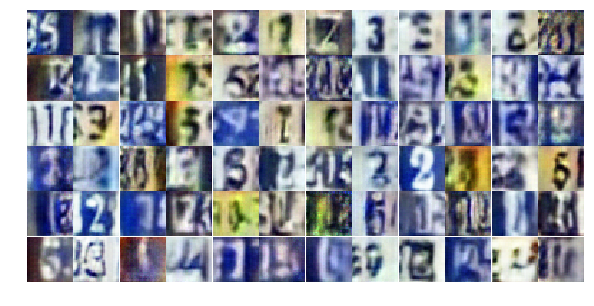

Epoch 5/10... Discriminator Loss: 0.7894... Generator Loss: 0.9288
Epoch 5/10... Discriminator Loss: 1.3416... Generator Loss: 0.4268
Epoch 5/10... Discriminator Loss: 1.0546... Generator Loss: 0.5903
Epoch 5/10... Discriminator Loss: 0.8516... Generator Loss: 1.0361
Epoch 5/10... Discriminator Loss: 1.3408... Generator Loss: 0.4279
Epoch 5/10... Discriminator Loss: 0.4372... Generator Loss: 1.5627
Epoch 5/10... Discriminator Loss: 1.7659... Generator Loss: 0.2555
Epoch 5/10... Discriminator Loss: 0.7866... Generator Loss: 1.1290
Epoch 5/10... Discriminator Loss: 1.2471... Generator Loss: 0.5114
Epoch 5/10... Discriminator Loss: 1.1803... Generator Loss: 0.5503


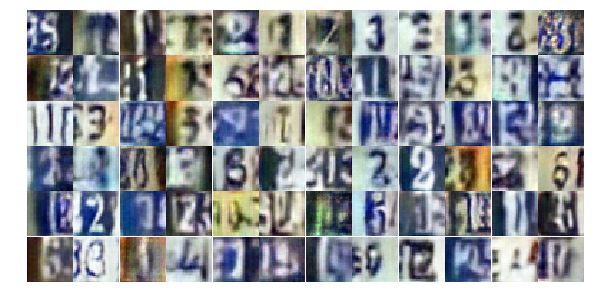

Epoch 5/10... Discriminator Loss: 1.3184... Generator Loss: 0.5022
Epoch 5/10... Discriminator Loss: 0.8013... Generator Loss: 0.7782
Epoch 5/10... Discriminator Loss: 0.8864... Generator Loss: 0.7432
Epoch 5/10... Discriminator Loss: 1.0574... Generator Loss: 0.9653
Epoch 5/10... Discriminator Loss: 0.8846... Generator Loss: 1.0928
Epoch 5/10... Discriminator Loss: 0.5765... Generator Loss: 1.1677
Epoch 5/10... Discriminator Loss: 0.9078... Generator Loss: 0.6739
Epoch 5/10... Discriminator Loss: 0.8997... Generator Loss: 0.7426
Epoch 5/10... Discriminator Loss: 0.9153... Generator Loss: 0.9383
Epoch 5/10... Discriminator Loss: 0.8481... Generator Loss: 1.1627


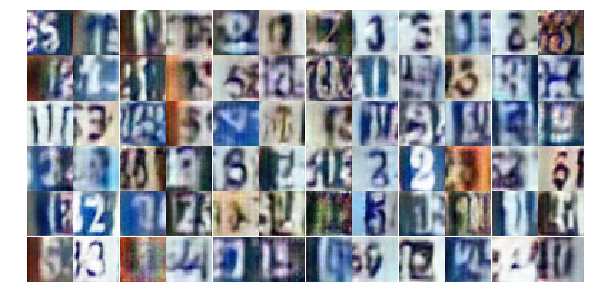

Epoch 5/10... Discriminator Loss: 0.8566... Generator Loss: 0.8865
Epoch 5/10... Discriminator Loss: 1.2372... Generator Loss: 1.5401
Epoch 5/10... Discriminator Loss: 0.7247... Generator Loss: 1.3322
Epoch 5/10... Discriminator Loss: 0.9873... Generator Loss: 0.6218
Epoch 5/10... Discriminator Loss: 1.3367... Generator Loss: 0.4227
Epoch 5/10... Discriminator Loss: 1.1565... Generator Loss: 0.5840
Epoch 5/10... Discriminator Loss: 0.8226... Generator Loss: 0.8107
Epoch 5/10... Discriminator Loss: 0.8645... Generator Loss: 0.7924
Epoch 5/10... Discriminator Loss: 0.7062... Generator Loss: 0.9687
Epoch 5/10... Discriminator Loss: 0.8645... Generator Loss: 1.5262


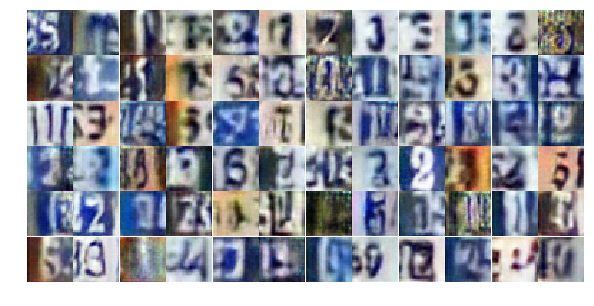

Epoch 5/10... Discriminator Loss: 0.9677... Generator Loss: 0.7353
Epoch 5/10... Discriminator Loss: 0.8404... Generator Loss: 1.3361
Epoch 6/10... Discriminator Loss: 0.9869... Generator Loss: 0.8219
Epoch 6/10... Discriminator Loss: 0.8930... Generator Loss: 1.1944
Epoch 6/10... Discriminator Loss: 0.7549... Generator Loss: 0.9982
Epoch 6/10... Discriminator Loss: 0.6033... Generator Loss: 1.3585
Epoch 6/10... Discriminator Loss: 0.8536... Generator Loss: 1.1615
Epoch 6/10... Discriminator Loss: 0.9842... Generator Loss: 0.6486
Epoch 6/10... Discriminator Loss: 1.3233... Generator Loss: 0.4290
Epoch 6/10... Discriminator Loss: 1.1406... Generator Loss: 0.6870


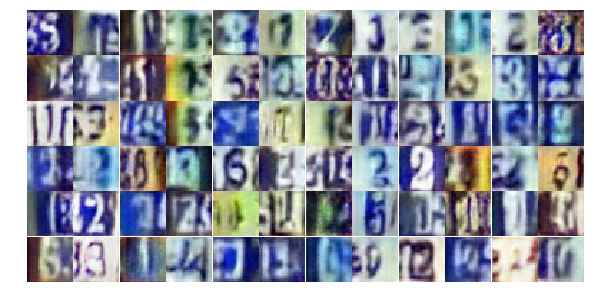

Epoch 6/10... Discriminator Loss: 0.9767... Generator Loss: 0.7560
Epoch 6/10... Discriminator Loss: 1.0219... Generator Loss: 0.7452
Epoch 6/10... Discriminator Loss: 0.8376... Generator Loss: 0.9331
Epoch 6/10... Discriminator Loss: 0.6591... Generator Loss: 1.1440
Epoch 6/10... Discriminator Loss: 0.9623... Generator Loss: 0.7152
Epoch 6/10... Discriminator Loss: 1.1332... Generator Loss: 0.6317
Epoch 6/10... Discriminator Loss: 0.9042... Generator Loss: 0.7433
Epoch 6/10... Discriminator Loss: 1.0170... Generator Loss: 0.6251
Epoch 6/10... Discriminator Loss: 0.8034... Generator Loss: 1.3216
Epoch 6/10... Discriminator Loss: 0.8516... Generator Loss: 1.2292


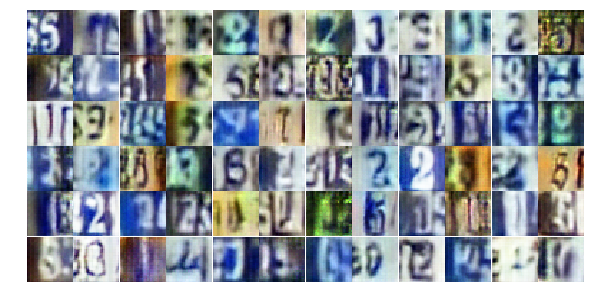

Epoch 6/10... Discriminator Loss: 1.0047... Generator Loss: 0.8441
Epoch 6/10... Discriminator Loss: 0.9440... Generator Loss: 0.8772
Epoch 6/10... Discriminator Loss: 0.9899... Generator Loss: 0.6754
Epoch 6/10... Discriminator Loss: 0.7736... Generator Loss: 1.0191
Epoch 6/10... Discriminator Loss: 0.6636... Generator Loss: 1.6143
Epoch 6/10... Discriminator Loss: 1.1200... Generator Loss: 0.6859
Epoch 6/10... Discriminator Loss: 0.9404... Generator Loss: 0.6414
Epoch 6/10... Discriminator Loss: 1.1660... Generator Loss: 1.8292
Epoch 6/10... Discriminator Loss: 1.2377... Generator Loss: 0.5357
Epoch 6/10... Discriminator Loss: 1.2689... Generator Loss: 0.4248


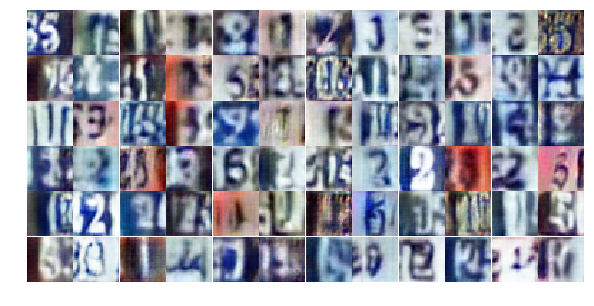

Epoch 6/10... Discriminator Loss: 0.8481... Generator Loss: 0.9638
Epoch 6/10... Discriminator Loss: 1.1049... Generator Loss: 0.5698
Epoch 6/10... Discriminator Loss: 1.3459... Generator Loss: 0.4056
Epoch 6/10... Discriminator Loss: 1.0514... Generator Loss: 0.6627
Epoch 6/10... Discriminator Loss: 1.0681... Generator Loss: 1.5142
Epoch 6/10... Discriminator Loss: 0.6878... Generator Loss: 1.2627
Epoch 6/10... Discriminator Loss: 0.9071... Generator Loss: 0.8662
Epoch 6/10... Discriminator Loss: 0.8052... Generator Loss: 0.8208
Epoch 6/10... Discriminator Loss: 1.2543... Generator Loss: 0.4436
Epoch 6/10... Discriminator Loss: 1.0837... Generator Loss: 0.6042


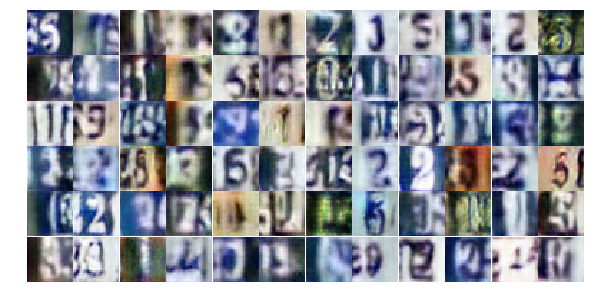

Epoch 6/10... Discriminator Loss: 1.3336... Generator Loss: 0.5963
Epoch 6/10... Discriminator Loss: 0.7451... Generator Loss: 0.9867
Epoch 6/10... Discriminator Loss: 0.7313... Generator Loss: 0.9141
Epoch 6/10... Discriminator Loss: 1.4123... Generator Loss: 0.3644
Epoch 6/10... Discriminator Loss: 1.1376... Generator Loss: 0.6141
Epoch 6/10... Discriminator Loss: 1.1658... Generator Loss: 0.4740
Epoch 6/10... Discriminator Loss: 0.7656... Generator Loss: 1.0874
Epoch 6/10... Discriminator Loss: 1.2816... Generator Loss: 0.4042
Epoch 6/10... Discriminator Loss: 0.9293... Generator Loss: 0.7462
Epoch 6/10... Discriminator Loss: 0.8692... Generator Loss: 1.1419


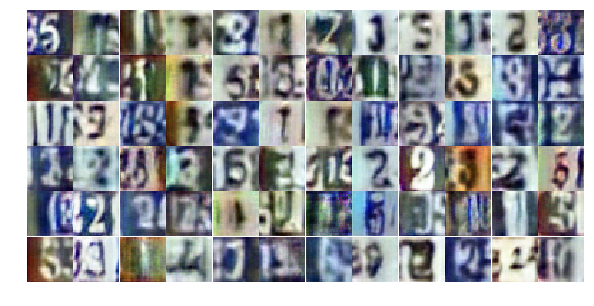

Epoch 6/10... Discriminator Loss: 0.4896... Generator Loss: 1.8835
Epoch 6/10... Discriminator Loss: 1.3845... Generator Loss: 0.3934
Epoch 6/10... Discriminator Loss: 0.9703... Generator Loss: 1.2288
Epoch 6/10... Discriminator Loss: 1.1900... Generator Loss: 0.4698
Epoch 6/10... Discriminator Loss: 0.8137... Generator Loss: 1.0450
Epoch 6/10... Discriminator Loss: 0.8869... Generator Loss: 1.1968
Epoch 6/10... Discriminator Loss: 0.5786... Generator Loss: 1.3155
Epoch 6/10... Discriminator Loss: 1.3567... Generator Loss: 0.4012
Epoch 6/10... Discriminator Loss: 1.0012... Generator Loss: 0.6585
Epoch 6/10... Discriminator Loss: 1.0199... Generator Loss: 0.6493


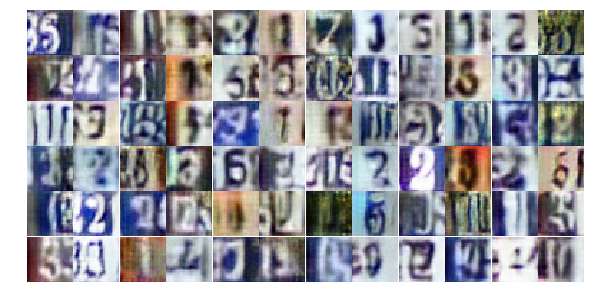

Epoch 6/10... Discriminator Loss: 1.2069... Generator Loss: 0.5188
Epoch 6/10... Discriminator Loss: 0.8913... Generator Loss: 1.2769
Epoch 6/10... Discriminator Loss: 0.5508... Generator Loss: 1.3941
Epoch 6/10... Discriminator Loss: 1.0222... Generator Loss: 0.9709
Epoch 6/10... Discriminator Loss: 1.0365... Generator Loss: 1.6053
Epoch 6/10... Discriminator Loss: 0.9578... Generator Loss: 0.7592
Epoch 6/10... Discriminator Loss: 1.0039... Generator Loss: 0.6845
Epoch 6/10... Discriminator Loss: 0.7186... Generator Loss: 1.2419
Epoch 6/10... Discriminator Loss: 0.8144... Generator Loss: 0.8034
Epoch 6/10... Discriminator Loss: 0.8499... Generator Loss: 1.0574


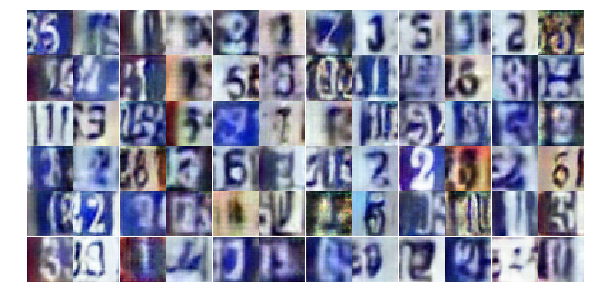

Epoch 6/10... Discriminator Loss: 1.0395... Generator Loss: 0.7220
Epoch 6/10... Discriminator Loss: 0.6210... Generator Loss: 1.2491
Epoch 6/10... Discriminator Loss: 1.1287... Generator Loss: 1.3576
Epoch 6/10... Discriminator Loss: 1.0169... Generator Loss: 0.8563
Epoch 6/10... Discriminator Loss: 0.8719... Generator Loss: 0.7596
Epoch 6/10... Discriminator Loss: 0.8855... Generator Loss: 0.9496
Epoch 6/10... Discriminator Loss: 0.8820... Generator Loss: 0.9700
Epoch 6/10... Discriminator Loss: 0.9102... Generator Loss: 1.3700
Epoch 6/10... Discriminator Loss: 0.8435... Generator Loss: 0.9054
Epoch 6/10... Discriminator Loss: 0.8053... Generator Loss: 1.1673


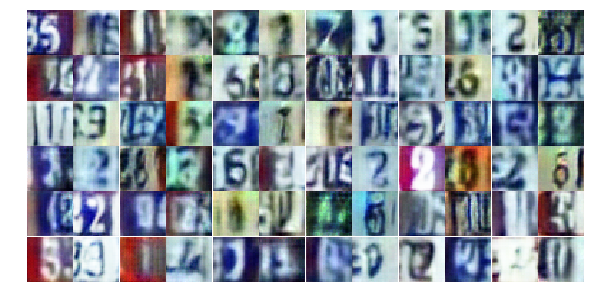

Epoch 6/10... Discriminator Loss: 0.9491... Generator Loss: 0.7611
Epoch 6/10... Discriminator Loss: 1.0260... Generator Loss: 0.6738
Epoch 6/10... Discriminator Loss: 0.8532... Generator Loss: 0.8229
Epoch 6/10... Discriminator Loss: 1.0376... Generator Loss: 0.6930
Epoch 6/10... Discriminator Loss: 1.0615... Generator Loss: 0.6594
Epoch 6/10... Discriminator Loss: 0.9096... Generator Loss: 0.6737
Epoch 6/10... Discriminator Loss: 1.2954... Generator Loss: 0.3974
Epoch 6/10... Discriminator Loss: 0.6799... Generator Loss: 1.1309
Epoch 6/10... Discriminator Loss: 0.7882... Generator Loss: 1.0422
Epoch 6/10... Discriminator Loss: 0.9285... Generator Loss: 0.9206


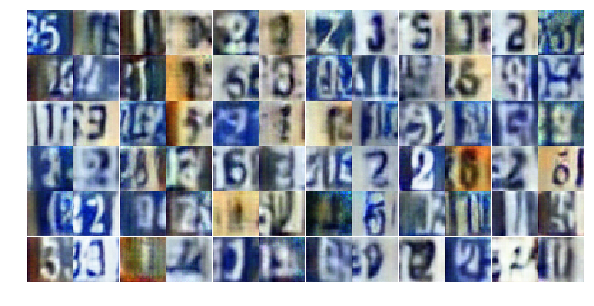

Epoch 6/10... Discriminator Loss: 1.3194... Generator Loss: 0.4527
Epoch 6/10... Discriminator Loss: 0.6640... Generator Loss: 1.4086
Epoch 6/10... Discriminator Loss: 1.3390... Generator Loss: 0.4440
Epoch 6/10... Discriminator Loss: 1.0160... Generator Loss: 0.8126
Epoch 6/10... Discriminator Loss: 0.6525... Generator Loss: 0.9775
Epoch 6/10... Discriminator Loss: 1.0628... Generator Loss: 0.8667
Epoch 6/10... Discriminator Loss: 1.4483... Generator Loss: 0.3452
Epoch 6/10... Discriminator Loss: 1.1177... Generator Loss: 0.6518
Epoch 6/10... Discriminator Loss: 1.0028... Generator Loss: 0.7091
Epoch 6/10... Discriminator Loss: 0.9424... Generator Loss: 0.7095


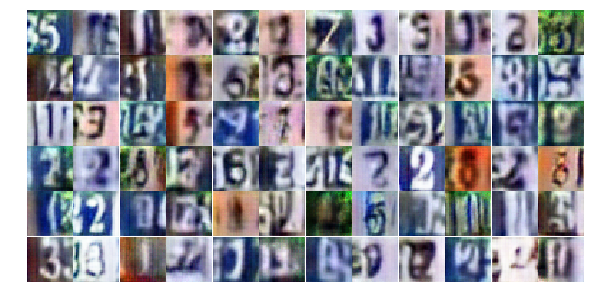

Epoch 6/10... Discriminator Loss: 0.8841... Generator Loss: 0.9817
Epoch 6/10... Discriminator Loss: 0.7964... Generator Loss: 0.9166
Epoch 6/10... Discriminator Loss: 0.8061... Generator Loss: 0.8845
Epoch 6/10... Discriminator Loss: 0.7853... Generator Loss: 0.9706
Epoch 6/10... Discriminator Loss: 1.1575... Generator Loss: 0.5946
Epoch 6/10... Discriminator Loss: 1.3167... Generator Loss: 0.4420
Epoch 6/10... Discriminator Loss: 0.7933... Generator Loss: 0.9818
Epoch 6/10... Discriminator Loss: 0.6053... Generator Loss: 1.0883
Epoch 6/10... Discriminator Loss: 0.8831... Generator Loss: 1.6855
Epoch 6/10... Discriminator Loss: 0.9092... Generator Loss: 1.0951


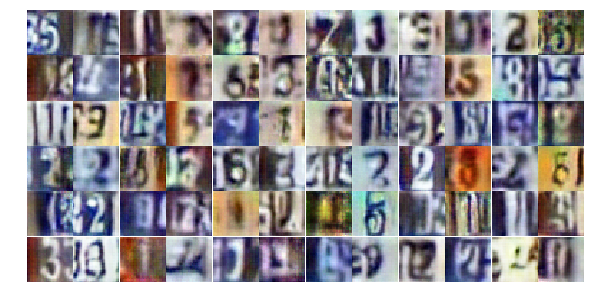

Epoch 6/10... Discriminator Loss: 0.8304... Generator Loss: 0.9893
Epoch 6/10... Discriminator Loss: 1.0592... Generator Loss: 0.6784
Epoch 6/10... Discriminator Loss: 0.9700... Generator Loss: 0.6690
Epoch 6/10... Discriminator Loss: 0.8557... Generator Loss: 0.7906
Epoch 6/10... Discriminator Loss: 0.9068... Generator Loss: 0.6901
Epoch 6/10... Discriminator Loss: 0.9670... Generator Loss: 0.8779
Epoch 6/10... Discriminator Loss: 0.8773... Generator Loss: 1.4441
Epoch 7/10... Discriminator Loss: 1.2972... Generator Loss: 0.4270
Epoch 7/10... Discriminator Loss: 1.0006... Generator Loss: 0.8318
Epoch 7/10... Discriminator Loss: 0.9010... Generator Loss: 0.7838


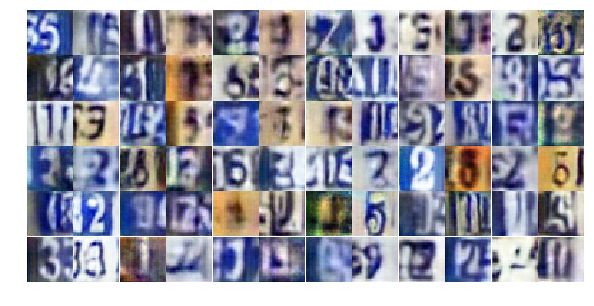

Epoch 7/10... Discriminator Loss: 0.8229... Generator Loss: 0.8801
Epoch 7/10... Discriminator Loss: 0.7254... Generator Loss: 0.9826
Epoch 7/10... Discriminator Loss: 1.0936... Generator Loss: 0.6801
Epoch 7/10... Discriminator Loss: 1.1568... Generator Loss: 0.5211
Epoch 7/10... Discriminator Loss: 1.2330... Generator Loss: 0.5041
Epoch 7/10... Discriminator Loss: 0.7863... Generator Loss: 0.8484
Epoch 7/10... Discriminator Loss: 1.1697... Generator Loss: 0.4623
Epoch 7/10... Discriminator Loss: 1.0524... Generator Loss: 0.5574
Epoch 7/10... Discriminator Loss: 1.0702... Generator Loss: 1.0326
Epoch 7/10... Discriminator Loss: 0.7897... Generator Loss: 1.0036


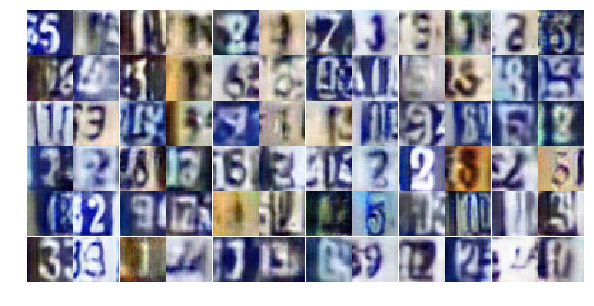

Epoch 7/10... Discriminator Loss: 0.6576... Generator Loss: 1.3368
Epoch 7/10... Discriminator Loss: 1.4638... Generator Loss: 0.4096
Epoch 7/10... Discriminator Loss: 0.6215... Generator Loss: 1.1538
Epoch 7/10... Discriminator Loss: 0.7928... Generator Loss: 1.3585
Epoch 7/10... Discriminator Loss: 0.9335... Generator Loss: 0.9269
Epoch 7/10... Discriminator Loss: 0.6056... Generator Loss: 1.3448
Epoch 7/10... Discriminator Loss: 0.8613... Generator Loss: 0.7759
Epoch 7/10... Discriminator Loss: 0.7697... Generator Loss: 0.9231
Epoch 7/10... Discriminator Loss: 0.7333... Generator Loss: 1.2244
Epoch 7/10... Discriminator Loss: 0.9879... Generator Loss: 0.8447


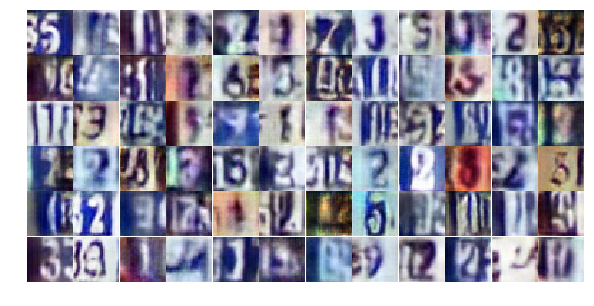

Epoch 7/10... Discriminator Loss: 0.6644... Generator Loss: 1.2668
Epoch 7/10... Discriminator Loss: 0.8698... Generator Loss: 1.2528
Epoch 7/10... Discriminator Loss: 0.7769... Generator Loss: 0.9445
Epoch 7/10... Discriminator Loss: 0.7866... Generator Loss: 0.9576
Epoch 7/10... Discriminator Loss: 0.9486... Generator Loss: 0.6742
Epoch 7/10... Discriminator Loss: 1.3726... Generator Loss: 0.4563
Epoch 7/10... Discriminator Loss: 0.8657... Generator Loss: 1.1596
Epoch 7/10... Discriminator Loss: 1.0190... Generator Loss: 0.5575
Epoch 7/10... Discriminator Loss: 1.0061... Generator Loss: 0.8011
Epoch 7/10... Discriminator Loss: 0.8903... Generator Loss: 0.9597


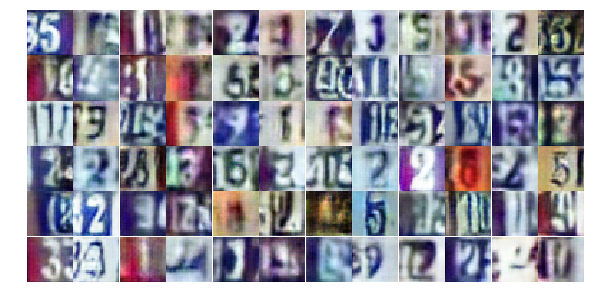

Epoch 7/10... Discriminator Loss: 0.8736... Generator Loss: 0.9333
Epoch 7/10... Discriminator Loss: 1.6912... Generator Loss: 0.2409
Epoch 7/10... Discriminator Loss: 0.6383... Generator Loss: 1.0213
Epoch 7/10... Discriminator Loss: 0.6967... Generator Loss: 1.0125
Epoch 7/10... Discriminator Loss: 0.8686... Generator Loss: 0.8552
Epoch 7/10... Discriminator Loss: 0.8235... Generator Loss: 0.9966
Epoch 7/10... Discriminator Loss: 1.4563... Generator Loss: 0.3465
Epoch 7/10... Discriminator Loss: 1.1215... Generator Loss: 0.5502
Epoch 7/10... Discriminator Loss: 0.7678... Generator Loss: 1.0465
Epoch 7/10... Discriminator Loss: 0.9013... Generator Loss: 0.8247


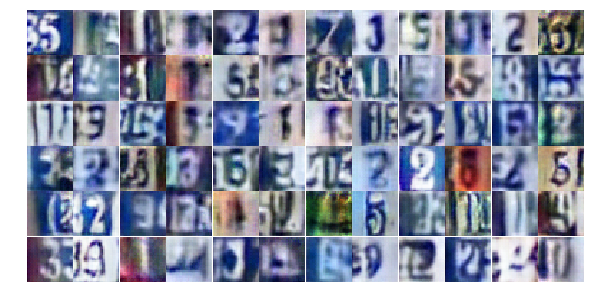

Epoch 7/10... Discriminator Loss: 0.5441... Generator Loss: 1.1130
Epoch 7/10... Discriminator Loss: 0.9661... Generator Loss: 0.6759
Epoch 7/10... Discriminator Loss: 0.8393... Generator Loss: 0.8467
Epoch 7/10... Discriminator Loss: 1.2531... Generator Loss: 0.4209
Epoch 7/10... Discriminator Loss: 1.0834... Generator Loss: 0.5310
Epoch 7/10... Discriminator Loss: 0.9688... Generator Loss: 0.6626
Epoch 7/10... Discriminator Loss: 1.0438... Generator Loss: 0.8371
Epoch 7/10... Discriminator Loss: 0.9101... Generator Loss: 0.6977
Epoch 7/10... Discriminator Loss: 0.5006... Generator Loss: 1.2917
Epoch 7/10... Discriminator Loss: 0.9190... Generator Loss: 0.8645


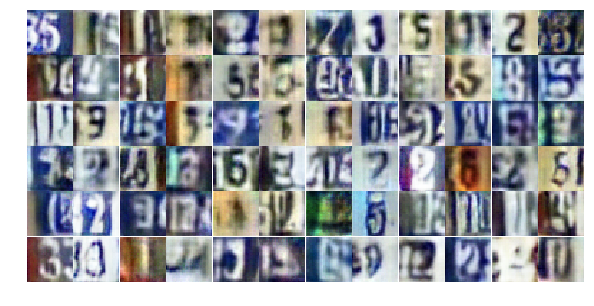

Epoch 7/10... Discriminator Loss: 0.8955... Generator Loss: 0.8511
Epoch 7/10... Discriminator Loss: 0.9894... Generator Loss: 0.7023
Epoch 7/10... Discriminator Loss: 0.6907... Generator Loss: 1.3294
Epoch 7/10... Discriminator Loss: 0.6744... Generator Loss: 0.9412
Epoch 7/10... Discriminator Loss: 0.8936... Generator Loss: 0.8603
Epoch 7/10... Discriminator Loss: 0.9328... Generator Loss: 0.9490
Epoch 7/10... Discriminator Loss: 1.1146... Generator Loss: 0.5571
Epoch 7/10... Discriminator Loss: 1.0335... Generator Loss: 0.6280
Epoch 7/10... Discriminator Loss: 0.7991... Generator Loss: 1.5596
Epoch 7/10... Discriminator Loss: 0.6370... Generator Loss: 1.0613


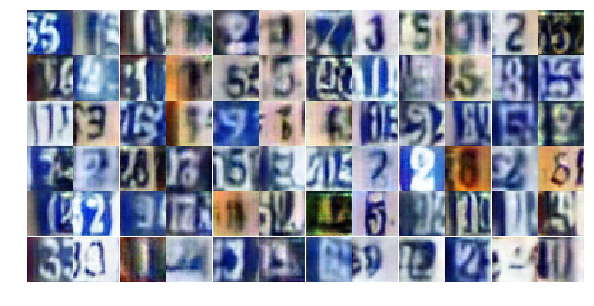

Epoch 7/10... Discriminator Loss: 0.9150... Generator Loss: 1.0211
Epoch 7/10... Discriminator Loss: 0.8160... Generator Loss: 0.8451
Epoch 7/10... Discriminator Loss: 1.0742... Generator Loss: 1.0658
Epoch 7/10... Discriminator Loss: 1.8326... Generator Loss: 0.2191
Epoch 7/10... Discriminator Loss: 1.0042... Generator Loss: 0.7663
Epoch 7/10... Discriminator Loss: 0.8661... Generator Loss: 1.2709
Epoch 7/10... Discriminator Loss: 1.5080... Generator Loss: 0.3540
Epoch 7/10... Discriminator Loss: 0.8496... Generator Loss: 0.8837
Epoch 7/10... Discriminator Loss: 0.7958... Generator Loss: 1.0027
Epoch 7/10... Discriminator Loss: 1.3240... Generator Loss: 0.3951


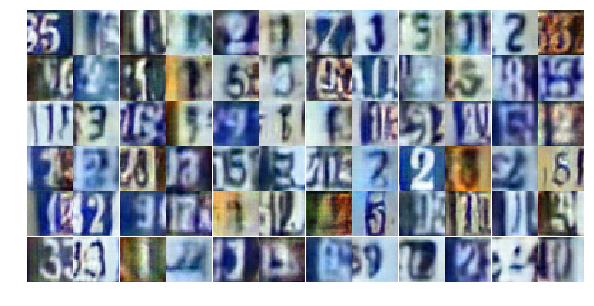

Epoch 7/10... Discriminator Loss: 0.9150... Generator Loss: 0.9953
Epoch 7/10... Discriminator Loss: 1.2819... Generator Loss: 0.4754
Epoch 7/10... Discriminator Loss: 1.1925... Generator Loss: 0.5264
Epoch 7/10... Discriminator Loss: 1.4904... Generator Loss: 0.3504
Epoch 7/10... Discriminator Loss: 0.7082... Generator Loss: 1.1322
Epoch 7/10... Discriminator Loss: 0.8938... Generator Loss: 0.7473
Epoch 7/10... Discriminator Loss: 0.8151... Generator Loss: 0.9767
Epoch 7/10... Discriminator Loss: 0.5408... Generator Loss: 1.2823
Epoch 7/10... Discriminator Loss: 0.9299... Generator Loss: 1.1849
Epoch 7/10... Discriminator Loss: 0.8887... Generator Loss: 1.4609


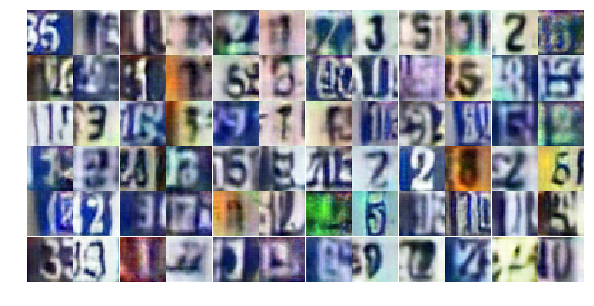

Epoch 7/10... Discriminator Loss: 0.8601... Generator Loss: 0.8095
Epoch 7/10... Discriminator Loss: 1.3888... Generator Loss: 0.4117
Epoch 7/10... Discriminator Loss: 0.8760... Generator Loss: 0.7674
Epoch 7/10... Discriminator Loss: 1.3496... Generator Loss: 0.4075
Epoch 7/10... Discriminator Loss: 0.6314... Generator Loss: 1.1928
Epoch 7/10... Discriminator Loss: 1.2947... Generator Loss: 0.5342
Epoch 7/10... Discriminator Loss: 0.7654... Generator Loss: 1.0513
Epoch 7/10... Discriminator Loss: 1.1904... Generator Loss: 0.6104
Epoch 7/10... Discriminator Loss: 0.8701... Generator Loss: 1.0018
Epoch 7/10... Discriminator Loss: 1.0354... Generator Loss: 0.6222


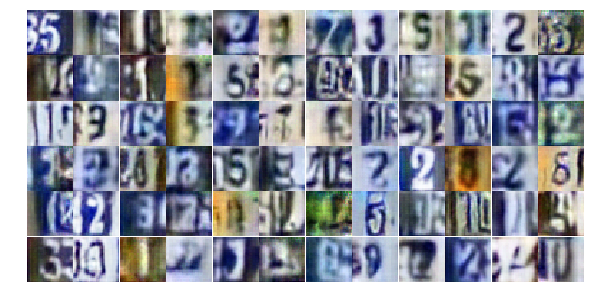

Epoch 7/10... Discriminator Loss: 0.7041... Generator Loss: 0.8854
Epoch 7/10... Discriminator Loss: 0.9014... Generator Loss: 0.6780
Epoch 7/10... Discriminator Loss: 1.1464... Generator Loss: 0.5418
Epoch 7/10... Discriminator Loss: 0.7723... Generator Loss: 1.2375
Epoch 7/10... Discriminator Loss: 0.6327... Generator Loss: 1.1728
Epoch 7/10... Discriminator Loss: 0.8214... Generator Loss: 0.7540
Epoch 7/10... Discriminator Loss: 0.6983... Generator Loss: 1.4856
Epoch 7/10... Discriminator Loss: 0.5996... Generator Loss: 1.4809
Epoch 7/10... Discriminator Loss: 0.7776... Generator Loss: 0.9431
Epoch 7/10... Discriminator Loss: 1.2515... Generator Loss: 0.5223


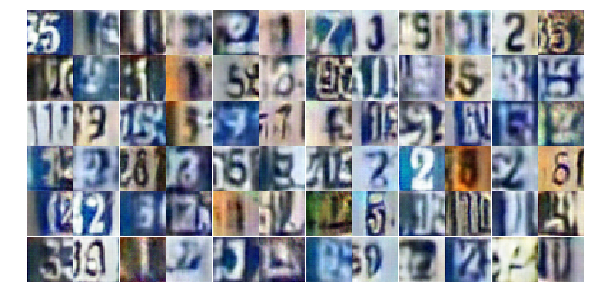

Epoch 7/10... Discriminator Loss: 1.0568... Generator Loss: 1.3212
Epoch 7/10... Discriminator Loss: 0.6764... Generator Loss: 1.3679
Epoch 7/10... Discriminator Loss: 0.8914... Generator Loss: 0.7131
Epoch 7/10... Discriminator Loss: 1.1973... Generator Loss: 0.4955
Epoch 7/10... Discriminator Loss: 0.9759... Generator Loss: 0.6590
Epoch 7/10... Discriminator Loss: 0.8044... Generator Loss: 0.7999
Epoch 7/10... Discriminator Loss: 0.9538... Generator Loss: 0.7097
Epoch 7/10... Discriminator Loss: 0.6152... Generator Loss: 1.1293
Epoch 7/10... Discriminator Loss: 0.9677... Generator Loss: 0.6701
Epoch 7/10... Discriminator Loss: 0.7786... Generator Loss: 1.2083


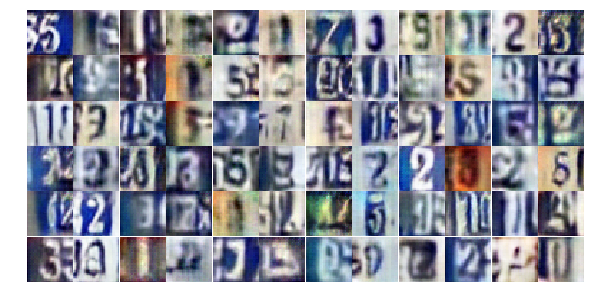

Epoch 7/10... Discriminator Loss: 0.7218... Generator Loss: 1.2242
Epoch 8/10... Discriminator Loss: 0.9117... Generator Loss: 0.7724
Epoch 8/10... Discriminator Loss: 0.9751... Generator Loss: 0.6819
Epoch 8/10... Discriminator Loss: 0.7960... Generator Loss: 0.8513
Epoch 8/10... Discriminator Loss: 0.8515... Generator Loss: 0.7912
Epoch 8/10... Discriminator Loss: 0.8245... Generator Loss: 0.9265
Epoch 8/10... Discriminator Loss: 1.2023... Generator Loss: 0.4552
Epoch 8/10... Discriminator Loss: 1.0306... Generator Loss: 0.6775
Epoch 8/10... Discriminator Loss: 0.9668... Generator Loss: 0.6591
Epoch 8/10... Discriminator Loss: 0.9168... Generator Loss: 0.8022


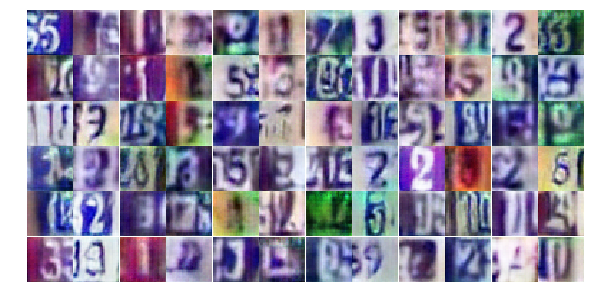

Epoch 8/10... Discriminator Loss: 1.1418... Generator Loss: 0.4824
Epoch 8/10... Discriminator Loss: 0.8832... Generator Loss: 0.7188
Epoch 8/10... Discriminator Loss: 1.0113... Generator Loss: 0.8172
Epoch 8/10... Discriminator Loss: 0.7943... Generator Loss: 1.3952
Epoch 8/10... Discriminator Loss: 1.2778... Generator Loss: 0.5844
Epoch 8/10... Discriminator Loss: 0.8186... Generator Loss: 0.7818
Epoch 8/10... Discriminator Loss: 0.9877... Generator Loss: 0.8191
Epoch 8/10... Discriminator Loss: 0.8666... Generator Loss: 0.7402
Epoch 8/10... Discriminator Loss: 0.9769... Generator Loss: 0.6816
Epoch 8/10... Discriminator Loss: 0.9952... Generator Loss: 0.9042


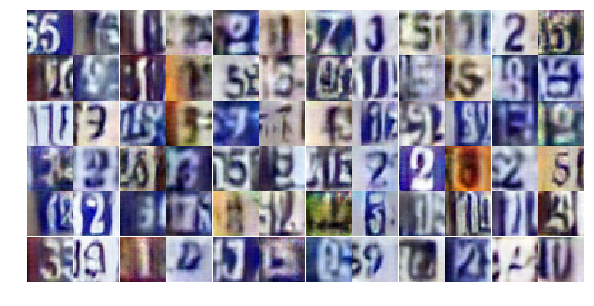

Epoch 8/10... Discriminator Loss: 0.7740... Generator Loss: 1.3190
Epoch 8/10... Discriminator Loss: 0.9013... Generator Loss: 0.6725
Epoch 8/10... Discriminator Loss: 0.7559... Generator Loss: 0.9322
Epoch 8/10... Discriminator Loss: 0.7599... Generator Loss: 0.8854
Epoch 8/10... Discriminator Loss: 0.8880... Generator Loss: 0.8199
Epoch 8/10... Discriminator Loss: 1.3553... Generator Loss: 0.4039
Epoch 8/10... Discriminator Loss: 0.8108... Generator Loss: 1.0861
Epoch 8/10... Discriminator Loss: 1.1017... Generator Loss: 1.1848
Epoch 8/10... Discriminator Loss: 0.9936... Generator Loss: 0.6334
Epoch 8/10... Discriminator Loss: 0.7496... Generator Loss: 1.0473


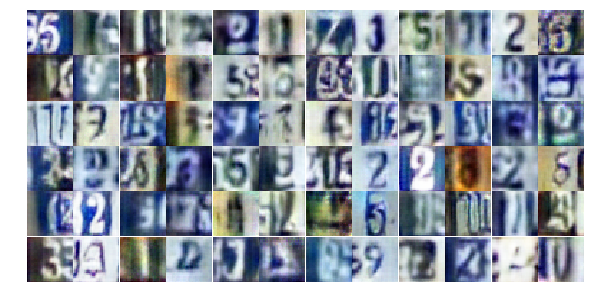

Epoch 8/10... Discriminator Loss: 1.3398... Generator Loss: 0.4140
Epoch 8/10... Discriminator Loss: 1.3498... Generator Loss: 0.3598
Epoch 8/10... Discriminator Loss: 0.8260... Generator Loss: 0.7517
Epoch 8/10... Discriminator Loss: 0.7755... Generator Loss: 1.1508
Epoch 8/10... Discriminator Loss: 0.7306... Generator Loss: 1.3594
Epoch 8/10... Discriminator Loss: 0.7507... Generator Loss: 1.0556
Epoch 8/10... Discriminator Loss: 0.8438... Generator Loss: 0.9232
Epoch 8/10... Discriminator Loss: 1.2572... Generator Loss: 0.4938
Epoch 8/10... Discriminator Loss: 1.1779... Generator Loss: 0.4707
Epoch 8/10... Discriminator Loss: 0.8534... Generator Loss: 0.9044


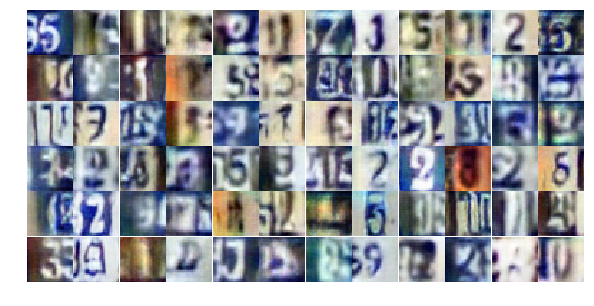

Epoch 8/10... Discriminator Loss: 0.6898... Generator Loss: 1.1720
Epoch 8/10... Discriminator Loss: 0.7434... Generator Loss: 0.9214
Epoch 8/10... Discriminator Loss: 1.2223... Generator Loss: 0.4679
Epoch 8/10... Discriminator Loss: 1.2131... Generator Loss: 0.4964
Epoch 8/10... Discriminator Loss: 0.8318... Generator Loss: 0.8156
Epoch 8/10... Discriminator Loss: 0.5279... Generator Loss: 1.3329
Epoch 8/10... Discriminator Loss: 1.3396... Generator Loss: 0.4056
Epoch 8/10... Discriminator Loss: 0.8533... Generator Loss: 0.6876
Epoch 8/10... Discriminator Loss: 0.9354... Generator Loss: 0.6870
Epoch 8/10... Discriminator Loss: 0.5199... Generator Loss: 1.5890


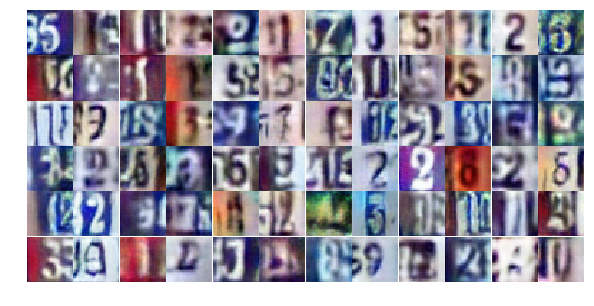

Epoch 8/10... Discriminator Loss: 0.9054... Generator Loss: 0.7665
Epoch 8/10... Discriminator Loss: 1.4371... Generator Loss: 0.3522
Epoch 8/10... Discriminator Loss: 0.7403... Generator Loss: 0.9924
Epoch 8/10... Discriminator Loss: 1.0916... Generator Loss: 0.5517
Epoch 8/10... Discriminator Loss: 1.1322... Generator Loss: 1.8605
Epoch 8/10... Discriminator Loss: 0.5036... Generator Loss: 1.4349
Epoch 8/10... Discriminator Loss: 1.7674... Generator Loss: 0.2263
Epoch 8/10... Discriminator Loss: 0.9663... Generator Loss: 0.9817
Epoch 8/10... Discriminator Loss: 0.9891... Generator Loss: 0.5957
Epoch 8/10... Discriminator Loss: 1.4613... Generator Loss: 0.3559


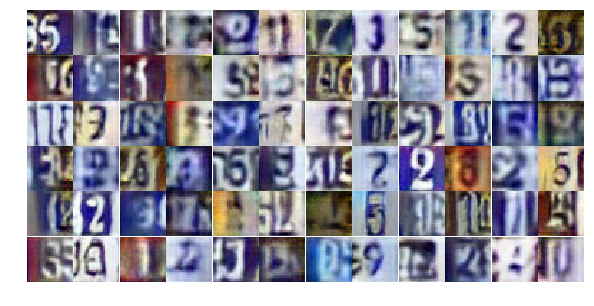

Epoch 8/10... Discriminator Loss: 0.9517... Generator Loss: 0.6811
Epoch 8/10... Discriminator Loss: 0.5579... Generator Loss: 1.7057
Epoch 8/10... Discriminator Loss: 0.8910... Generator Loss: 1.1772
Epoch 8/10... Discriminator Loss: 0.7547... Generator Loss: 0.9622
Epoch 8/10... Discriminator Loss: 0.9784... Generator Loss: 0.9111
Epoch 8/10... Discriminator Loss: 0.9325... Generator Loss: 0.8900
Epoch 8/10... Discriminator Loss: 0.7231... Generator Loss: 1.6092
Epoch 8/10... Discriminator Loss: 0.7617... Generator Loss: 1.2083
Epoch 8/10... Discriminator Loss: 0.8616... Generator Loss: 1.0943
Epoch 8/10... Discriminator Loss: 0.9118... Generator Loss: 0.6782


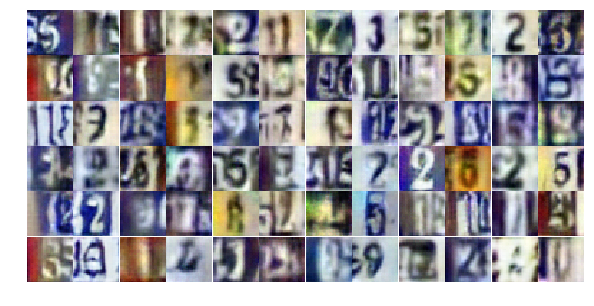

Epoch 8/10... Discriminator Loss: 0.5457... Generator Loss: 1.3020
Epoch 8/10... Discriminator Loss: 1.1549... Generator Loss: 1.1015
Epoch 8/10... Discriminator Loss: 1.3891... Generator Loss: 0.5677
Epoch 8/10... Discriminator Loss: 0.8448... Generator Loss: 0.7984
Epoch 8/10... Discriminator Loss: 0.9560... Generator Loss: 0.6738
Epoch 8/10... Discriminator Loss: 0.7714... Generator Loss: 1.0851
Epoch 8/10... Discriminator Loss: 0.8125... Generator Loss: 1.4267
Epoch 8/10... Discriminator Loss: 0.9367... Generator Loss: 0.8856
Epoch 8/10... Discriminator Loss: 1.3507... Generator Loss: 0.4165
Epoch 8/10... Discriminator Loss: 0.8438... Generator Loss: 0.8842


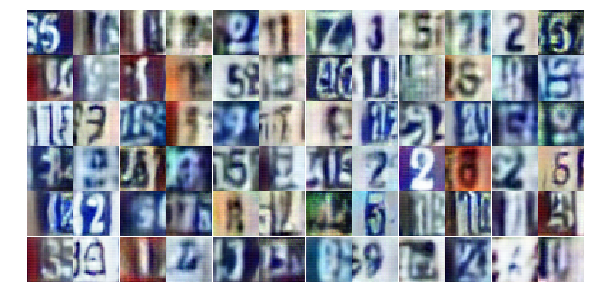

Epoch 8/10... Discriminator Loss: 1.0966... Generator Loss: 0.6664
Epoch 8/10... Discriminator Loss: 0.7936... Generator Loss: 0.9864
Epoch 8/10... Discriminator Loss: 1.0476... Generator Loss: 0.6747
Epoch 8/10... Discriminator Loss: 0.9664... Generator Loss: 0.6271
Epoch 8/10... Discriminator Loss: 1.1487... Generator Loss: 0.4716
Epoch 8/10... Discriminator Loss: 1.1149... Generator Loss: 0.5613
Epoch 8/10... Discriminator Loss: 0.6177... Generator Loss: 1.3642
Epoch 8/10... Discriminator Loss: 0.5238... Generator Loss: 1.3512
Epoch 8/10... Discriminator Loss: 0.9365... Generator Loss: 0.6545
Epoch 8/10... Discriminator Loss: 1.3931... Generator Loss: 0.4050


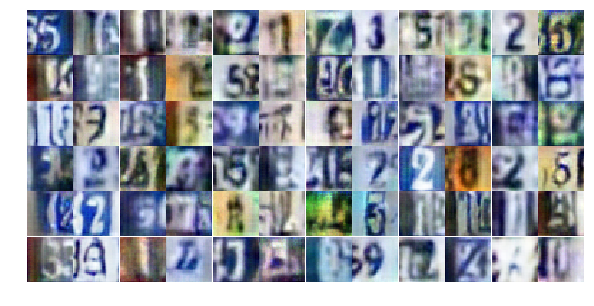

Epoch 8/10... Discriminator Loss: 0.6201... Generator Loss: 1.1604
Epoch 8/10... Discriminator Loss: 1.2812... Generator Loss: 0.5149
Epoch 8/10... Discriminator Loss: 1.0470... Generator Loss: 0.7016
Epoch 8/10... Discriminator Loss: 1.0842... Generator Loss: 0.5968
Epoch 8/10... Discriminator Loss: 1.0135... Generator Loss: 0.6869
Epoch 8/10... Discriminator Loss: 1.4979... Generator Loss: 0.3142
Epoch 8/10... Discriminator Loss: 1.3472... Generator Loss: 0.3717
Epoch 8/10... Discriminator Loss: 0.8644... Generator Loss: 0.9176
Epoch 8/10... Discriminator Loss: 0.9695... Generator Loss: 0.7091
Epoch 8/10... Discriminator Loss: 0.9071... Generator Loss: 0.7487


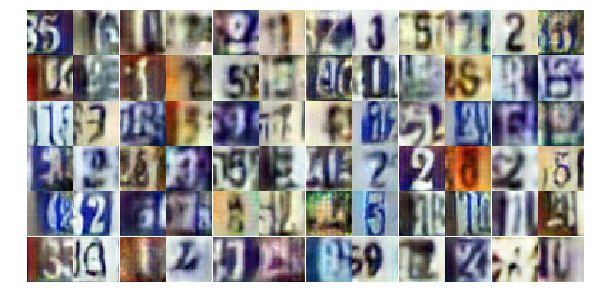

Epoch 8/10... Discriminator Loss: 1.0378... Generator Loss: 0.8059
Epoch 8/10... Discriminator Loss: 1.0568... Generator Loss: 0.6017
Epoch 8/10... Discriminator Loss: 0.8759... Generator Loss: 0.7635
Epoch 8/10... Discriminator Loss: 1.0492... Generator Loss: 0.7230
Epoch 8/10... Discriminator Loss: 0.8915... Generator Loss: 0.8287
Epoch 8/10... Discriminator Loss: 0.6833... Generator Loss: 0.9498
Epoch 8/10... Discriminator Loss: 0.5006... Generator Loss: 1.2846
Epoch 8/10... Discriminator Loss: 0.7785... Generator Loss: 1.4279
Epoch 8/10... Discriminator Loss: 0.7472... Generator Loss: 1.1596
Epoch 8/10... Discriminator Loss: 1.1495... Generator Loss: 0.5650


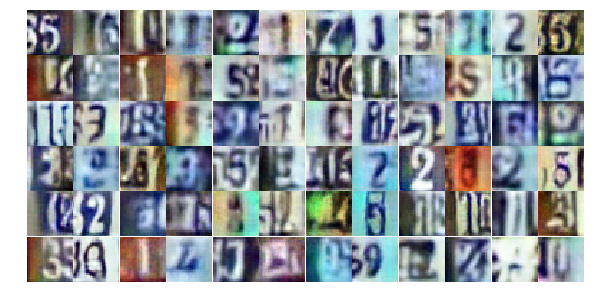

Epoch 8/10... Discriminator Loss: 1.0546... Generator Loss: 0.5441
Epoch 8/10... Discriminator Loss: 0.7528... Generator Loss: 1.1019
Epoch 8/10... Discriminator Loss: 0.7878... Generator Loss: 0.9229
Epoch 8/10... Discriminator Loss: 0.7520... Generator Loss: 0.8664
Epoch 8/10... Discriminator Loss: 0.9256... Generator Loss: 0.6745
Epoch 8/10... Discriminator Loss: 0.8233... Generator Loss: 0.8009
Epoch 9/10... Discriminator Loss: 1.2634... Generator Loss: 0.5812
Epoch 9/10... Discriminator Loss: 1.0717... Generator Loss: 0.8538
Epoch 9/10... Discriminator Loss: 0.7514... Generator Loss: 1.1728
Epoch 9/10... Discriminator Loss: 0.7303... Generator Loss: 0.9133


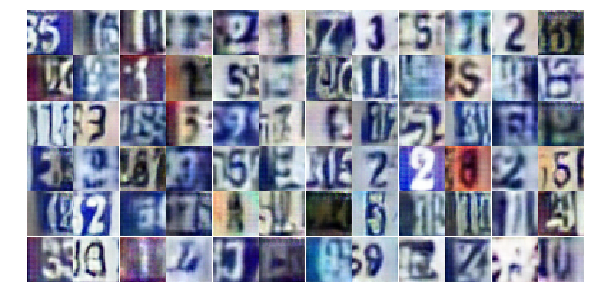

Epoch 9/10... Discriminator Loss: 0.8073... Generator Loss: 0.9901
Epoch 9/10... Discriminator Loss: 1.0089... Generator Loss: 0.6285
Epoch 9/10... Discriminator Loss: 1.0235... Generator Loss: 0.5646
Epoch 9/10... Discriminator Loss: 0.8073... Generator Loss: 1.1939
Epoch 9/10... Discriminator Loss: 0.8954... Generator Loss: 0.7270
Epoch 9/10... Discriminator Loss: 1.1342... Generator Loss: 0.7132
Epoch 9/10... Discriminator Loss: 0.9931... Generator Loss: 0.6196
Epoch 9/10... Discriminator Loss: 1.3799... Generator Loss: 0.4463
Epoch 9/10... Discriminator Loss: 0.7245... Generator Loss: 0.8551
Epoch 9/10... Discriminator Loss: 0.6425... Generator Loss: 1.1525


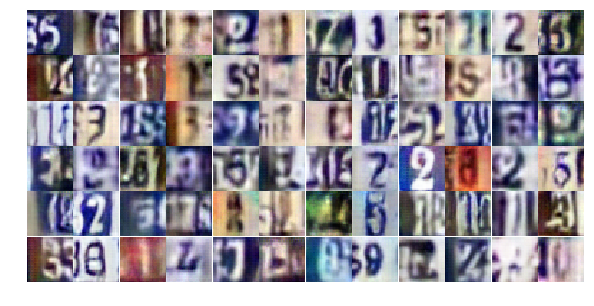

Epoch 9/10... Discriminator Loss: 1.3252... Generator Loss: 0.4546
Epoch 9/10... Discriminator Loss: 0.6665... Generator Loss: 1.2163
Epoch 9/10... Discriminator Loss: 0.7476... Generator Loss: 1.1985
Epoch 9/10... Discriminator Loss: 0.9170... Generator Loss: 0.7338
Epoch 9/10... Discriminator Loss: 0.6098... Generator Loss: 1.4503
Epoch 9/10... Discriminator Loss: 0.9119... Generator Loss: 0.6592
Epoch 9/10... Discriminator Loss: 0.6751... Generator Loss: 1.0521
Epoch 9/10... Discriminator Loss: 0.7311... Generator Loss: 1.0744
Epoch 9/10... Discriminator Loss: 1.2852... Generator Loss: 1.6984
Epoch 9/10... Discriminator Loss: 0.7519... Generator Loss: 1.2390


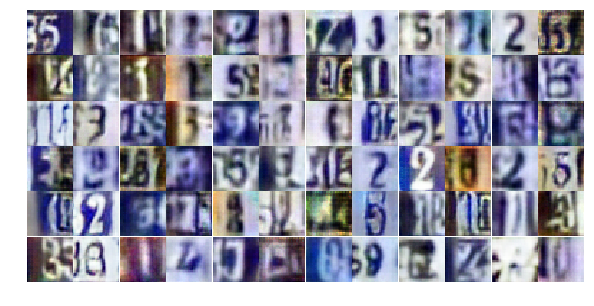

Epoch 9/10... Discriminator Loss: 1.0561... Generator Loss: 0.6829
Epoch 9/10... Discriminator Loss: 1.1439... Generator Loss: 0.6298
Epoch 9/10... Discriminator Loss: 0.9841... Generator Loss: 0.6755
Epoch 9/10... Discriminator Loss: 0.8071... Generator Loss: 1.1321
Epoch 9/10... Discriminator Loss: 0.9384... Generator Loss: 0.8626
Epoch 9/10... Discriminator Loss: 0.7688... Generator Loss: 0.9913
Epoch 9/10... Discriminator Loss: 0.9583... Generator Loss: 0.6843
Epoch 9/10... Discriminator Loss: 1.1006... Generator Loss: 0.6169
Epoch 9/10... Discriminator Loss: 0.9835... Generator Loss: 1.2337
Epoch 9/10... Discriminator Loss: 0.8912... Generator Loss: 0.8935


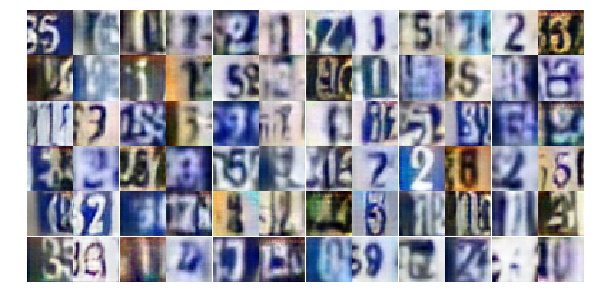

Epoch 9/10... Discriminator Loss: 1.3853... Generator Loss: 0.3949
Epoch 9/10... Discriminator Loss: 0.7513... Generator Loss: 1.2339
Epoch 9/10... Discriminator Loss: 0.6471... Generator Loss: 0.9256
Epoch 9/10... Discriminator Loss: 1.1882... Generator Loss: 0.4626
Epoch 9/10... Discriminator Loss: 0.7066... Generator Loss: 1.0532
Epoch 9/10... Discriminator Loss: 1.2780... Generator Loss: 0.4302
Epoch 9/10... Discriminator Loss: 1.3080... Generator Loss: 0.4310
Epoch 9/10... Discriminator Loss: 0.8812... Generator Loss: 0.7693
Epoch 9/10... Discriminator Loss: 0.9074... Generator Loss: 0.8295
Epoch 9/10... Discriminator Loss: 0.5419... Generator Loss: 1.2460


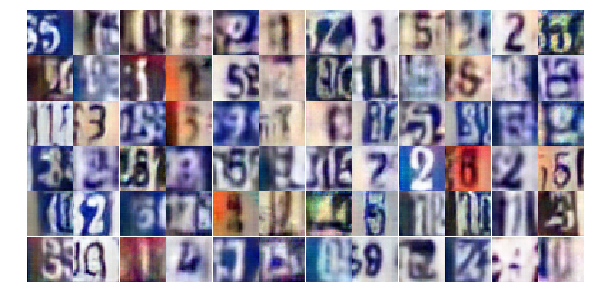

Epoch 9/10... Discriminator Loss: 0.7411... Generator Loss: 1.1402
Epoch 9/10... Discriminator Loss: 0.5150... Generator Loss: 1.2486
Epoch 9/10... Discriminator Loss: 1.0977... Generator Loss: 0.5836
Epoch 9/10... Discriminator Loss: 0.8697... Generator Loss: 0.7479
Epoch 9/10... Discriminator Loss: 1.3995... Generator Loss: 0.4014
Epoch 9/10... Discriminator Loss: 1.2776... Generator Loss: 0.7157
Epoch 9/10... Discriminator Loss: 1.0495... Generator Loss: 0.6599
Epoch 9/10... Discriminator Loss: 0.6299... Generator Loss: 0.9862
Epoch 9/10... Discriminator Loss: 0.8438... Generator Loss: 0.8209
Epoch 9/10... Discriminator Loss: 1.1116... Generator Loss: 0.5651


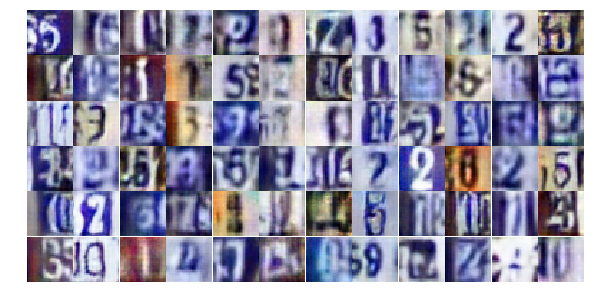

Epoch 9/10... Discriminator Loss: 1.0708... Generator Loss: 0.5536
Epoch 9/10... Discriminator Loss: 1.0228... Generator Loss: 0.9162
Epoch 9/10... Discriminator Loss: 0.7560... Generator Loss: 0.8828
Epoch 9/10... Discriminator Loss: 0.8752... Generator Loss: 1.0830
Epoch 9/10... Discriminator Loss: 0.7144... Generator Loss: 1.0388
Epoch 9/10... Discriminator Loss: 1.1205... Generator Loss: 0.4922
Epoch 9/10... Discriminator Loss: 0.9805... Generator Loss: 0.6455
Epoch 9/10... Discriminator Loss: 0.8463... Generator Loss: 0.7633
Epoch 9/10... Discriminator Loss: 0.7726... Generator Loss: 0.9790
Epoch 9/10... Discriminator Loss: 0.7988... Generator Loss: 1.0723


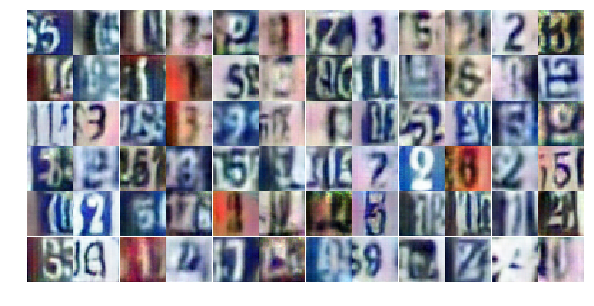

Epoch 9/10... Discriminator Loss: 0.8773... Generator Loss: 0.9135
Epoch 9/10... Discriminator Loss: 1.1081... Generator Loss: 1.5436
Epoch 9/10... Discriminator Loss: 1.9910... Generator Loss: 0.2035
Epoch 9/10... Discriminator Loss: 1.0950... Generator Loss: 0.8182
Epoch 9/10... Discriminator Loss: 0.7671... Generator Loss: 1.0100
Epoch 9/10... Discriminator Loss: 1.0058... Generator Loss: 0.9637
Epoch 9/10... Discriminator Loss: 1.1218... Generator Loss: 0.6243
Epoch 9/10... Discriminator Loss: 0.8410... Generator Loss: 1.1337
Epoch 9/10... Discriminator Loss: 1.4554... Generator Loss: 0.3607
Epoch 9/10... Discriminator Loss: 0.8451... Generator Loss: 1.0235


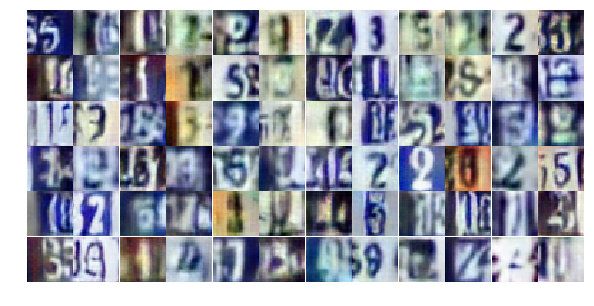

Epoch 9/10... Discriminator Loss: 1.2152... Generator Loss: 0.6141
Epoch 9/10... Discriminator Loss: 0.9992... Generator Loss: 0.6290
Epoch 9/10... Discriminator Loss: 1.3411... Generator Loss: 0.3588
Epoch 9/10... Discriminator Loss: 0.6404... Generator Loss: 1.7033
Epoch 9/10... Discriminator Loss: 0.8353... Generator Loss: 0.7110
Epoch 9/10... Discriminator Loss: 0.9628... Generator Loss: 0.7270
Epoch 9/10... Discriminator Loss: 0.6267... Generator Loss: 1.4289
Epoch 9/10... Discriminator Loss: 0.8026... Generator Loss: 1.1264
Epoch 9/10... Discriminator Loss: 0.7861... Generator Loss: 0.9272
Epoch 9/10... Discriminator Loss: 1.4000... Generator Loss: 0.3428


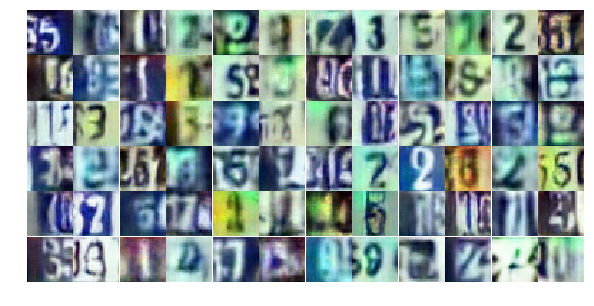

Epoch 9/10... Discriminator Loss: 0.9158... Generator Loss: 0.7336
Epoch 9/10... Discriminator Loss: 0.8660... Generator Loss: 0.8574
Epoch 9/10... Discriminator Loss: 1.5286... Generator Loss: 0.3463
Epoch 9/10... Discriminator Loss: 0.4503... Generator Loss: 1.6456
Epoch 9/10... Discriminator Loss: 1.5415... Generator Loss: 0.3212
Epoch 9/10... Discriminator Loss: 0.6397... Generator Loss: 1.0718
Epoch 9/10... Discriminator Loss: 1.1407... Generator Loss: 0.5377
Epoch 9/10... Discriminator Loss: 0.9293... Generator Loss: 0.8295
Epoch 9/10... Discriminator Loss: 1.1323... Generator Loss: 0.5751
Epoch 9/10... Discriminator Loss: 0.8045... Generator Loss: 0.7732


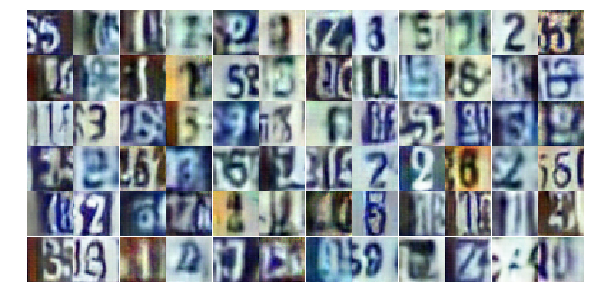

Epoch 9/10... Discriminator Loss: 0.8082... Generator Loss: 0.8343
Epoch 9/10... Discriminator Loss: 1.3451... Generator Loss: 0.3803
Epoch 9/10... Discriminator Loss: 0.6804... Generator Loss: 1.0362
Epoch 9/10... Discriminator Loss: 0.6974... Generator Loss: 0.8446
Epoch 9/10... Discriminator Loss: 0.9440... Generator Loss: 0.5975
Epoch 9/10... Discriminator Loss: 0.8249... Generator Loss: 0.8943
Epoch 9/10... Discriminator Loss: 0.7150... Generator Loss: 0.9026
Epoch 9/10... Discriminator Loss: 0.9161... Generator Loss: 0.9888
Epoch 9/10... Discriminator Loss: 0.5368... Generator Loss: 1.3871
Epoch 9/10... Discriminator Loss: 0.9195... Generator Loss: 0.8355


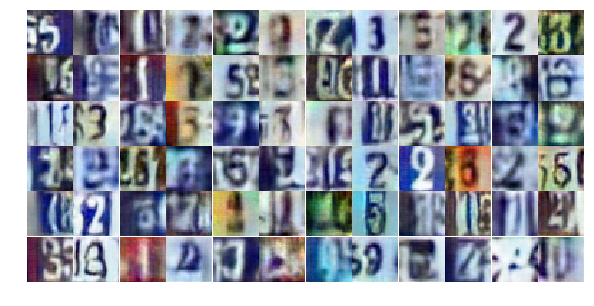

Epoch 9/10... Discriminator Loss: 0.9152... Generator Loss: 1.4815
Epoch 9/10... Discriminator Loss: 0.7293... Generator Loss: 0.8804
Epoch 9/10... Discriminator Loss: 1.0321... Generator Loss: 0.6745
Epoch 9/10... Discriminator Loss: 1.0824... Generator Loss: 0.5948
Epoch 9/10... Discriminator Loss: 0.8852... Generator Loss: 0.7700
Epoch 9/10... Discriminator Loss: 0.9362... Generator Loss: 0.7416
Epoch 9/10... Discriminator Loss: 0.7969... Generator Loss: 0.7287
Epoch 9/10... Discriminator Loss: 0.8234... Generator Loss: 0.8046
Epoch 9/10... Discriminator Loss: 0.7985... Generator Loss: 0.7972
Epoch 9/10... Discriminator Loss: 0.7760... Generator Loss: 1.0970


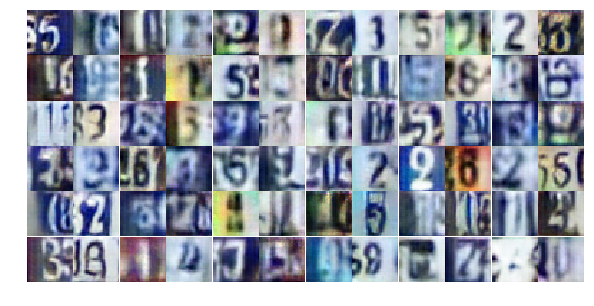

Epoch 10/10... Discriminator Loss: 0.8471... Generator Loss: 0.8356
Epoch 10/10... Discriminator Loss: 1.0684... Generator Loss: 0.7221
Epoch 10/10... Discriminator Loss: 0.6206... Generator Loss: 1.2541
Epoch 10/10... Discriminator Loss: 0.8418... Generator Loss: 0.7585
Epoch 10/10... Discriminator Loss: 0.7185... Generator Loss: 0.8841
Epoch 10/10... Discriminator Loss: 0.9806... Generator Loss: 0.7312
Epoch 10/10... Discriminator Loss: 0.9069... Generator Loss: 0.7542
Epoch 10/10... Discriminator Loss: 1.0378... Generator Loss: 0.5889
Epoch 10/10... Discriminator Loss: 1.0081... Generator Loss: 0.7519
Epoch 10/10... Discriminator Loss: 1.0154... Generator Loss: 0.5835


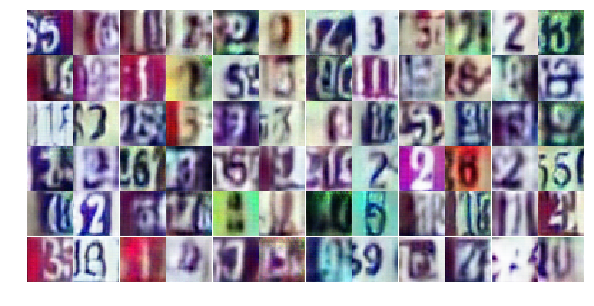

Epoch 10/10... Discriminator Loss: 0.7913... Generator Loss: 0.8580
Epoch 10/10... Discriminator Loss: 1.0538... Generator Loss: 0.6311
Epoch 10/10... Discriminator Loss: 0.9220... Generator Loss: 1.1817
Epoch 10/10... Discriminator Loss: 1.1043... Generator Loss: 0.6108
Epoch 10/10... Discriminator Loss: 0.6770... Generator Loss: 1.1249
Epoch 10/10... Discriminator Loss: 0.8963... Generator Loss: 0.8143
Epoch 10/10... Discriminator Loss: 0.8521... Generator Loss: 0.7683
Epoch 10/10... Discriminator Loss: 0.9040... Generator Loss: 0.7619
Epoch 10/10... Discriminator Loss: 0.7379... Generator Loss: 1.2751
Epoch 10/10... Discriminator Loss: 0.8466... Generator Loss: 0.9125


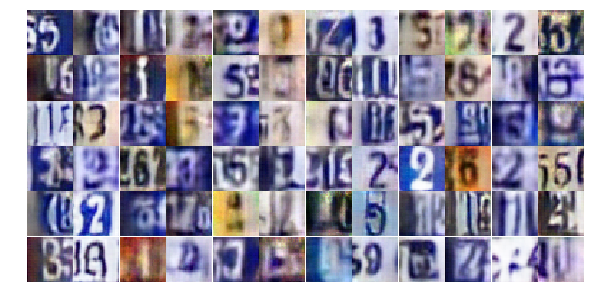

Epoch 10/10... Discriminator Loss: 0.8933... Generator Loss: 0.7184
Epoch 10/10... Discriminator Loss: 0.7651... Generator Loss: 0.8642
Epoch 10/10... Discriminator Loss: 0.7835... Generator Loss: 0.7775
Epoch 10/10... Discriminator Loss: 0.8692... Generator Loss: 0.9297
Epoch 10/10... Discriminator Loss: 1.4197... Generator Loss: 0.3211
Epoch 10/10... Discriminator Loss: 0.8960... Generator Loss: 0.6662
Epoch 10/10... Discriminator Loss: 1.1516... Generator Loss: 0.7408
Epoch 10/10... Discriminator Loss: 1.2050... Generator Loss: 0.5355
Epoch 10/10... Discriminator Loss: 0.9199... Generator Loss: 0.9003
Epoch 10/10... Discriminator Loss: 1.1294... Generator Loss: 0.5154


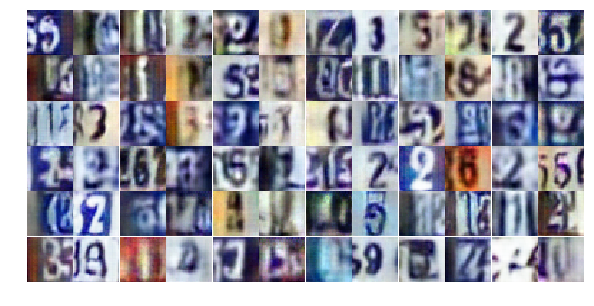

Epoch 10/10... Discriminator Loss: 1.5111... Generator Loss: 0.3716
Epoch 10/10... Discriminator Loss: 1.5955... Generator Loss: 0.3250
Epoch 10/10... Discriminator Loss: 0.8012... Generator Loss: 0.7614
Epoch 10/10... Discriminator Loss: 0.6492... Generator Loss: 1.3185
Epoch 10/10... Discriminator Loss: 0.7587... Generator Loss: 0.9442
Epoch 10/10... Discriminator Loss: 1.0945... Generator Loss: 0.6355
Epoch 10/10... Discriminator Loss: 1.3804... Generator Loss: 0.4057
Epoch 10/10... Discriminator Loss: 1.1343... Generator Loss: 0.5701
Epoch 10/10... Discriminator Loss: 0.8745... Generator Loss: 1.2861
Epoch 10/10... Discriminator Loss: 0.6451... Generator Loss: 1.2838


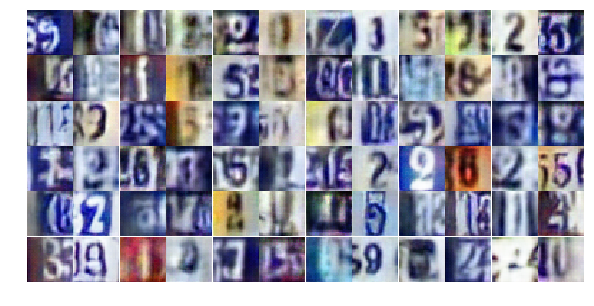

Epoch 10/10... Discriminator Loss: 0.7466... Generator Loss: 0.8072
Epoch 10/10... Discriminator Loss: 0.9428... Generator Loss: 0.6505
Epoch 10/10... Discriminator Loss: 1.5737... Generator Loss: 0.3092
Epoch 10/10... Discriminator Loss: 1.2140... Generator Loss: 0.4721
Epoch 10/10... Discriminator Loss: 0.7285... Generator Loss: 0.9132
Epoch 10/10... Discriminator Loss: 1.3864... Generator Loss: 0.3785
Epoch 10/10... Discriminator Loss: 0.9954... Generator Loss: 0.5761
Epoch 10/10... Discriminator Loss: 1.2964... Generator Loss: 0.4553
Epoch 10/10... Discriminator Loss: 0.6787... Generator Loss: 1.7734
Epoch 10/10... Discriminator Loss: 1.0626... Generator Loss: 0.6480


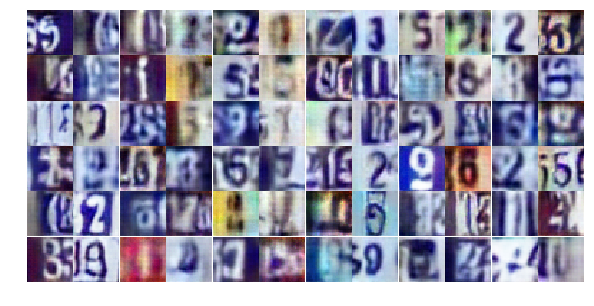

Epoch 10/10... Discriminator Loss: 1.2726... Generator Loss: 0.4401
Epoch 10/10... Discriminator Loss: 0.9973... Generator Loss: 0.7328
Epoch 10/10... Discriminator Loss: 0.9015... Generator Loss: 0.7830
Epoch 10/10... Discriminator Loss: 0.6840... Generator Loss: 1.4442
Epoch 10/10... Discriminator Loss: 0.4880... Generator Loss: 2.3507
Epoch 10/10... Discriminator Loss: 1.3847... Generator Loss: 0.4033
Epoch 10/10... Discriminator Loss: 0.9809... Generator Loss: 0.6698
Epoch 10/10... Discriminator Loss: 0.8000... Generator Loss: 0.7625
Epoch 10/10... Discriminator Loss: 1.1096... Generator Loss: 0.5785
Epoch 10/10... Discriminator Loss: 0.5986... Generator Loss: 1.1653


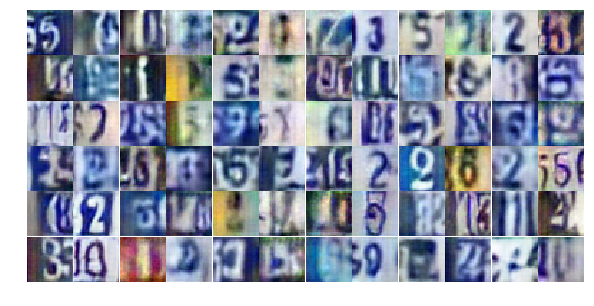

Epoch 10/10... Discriminator Loss: 0.6108... Generator Loss: 0.9231
Epoch 10/10... Discriminator Loss: 0.7607... Generator Loss: 1.6899
Epoch 10/10... Discriminator Loss: 0.8606... Generator Loss: 0.8058
Epoch 10/10... Discriminator Loss: 1.1595... Generator Loss: 0.5177
Epoch 10/10... Discriminator Loss: 0.7901... Generator Loss: 1.4378
Epoch 10/10... Discriminator Loss: 1.0117... Generator Loss: 0.8229
Epoch 10/10... Discriminator Loss: 0.5262... Generator Loss: 1.4310
Epoch 10/10... Discriminator Loss: 0.7753... Generator Loss: 1.5128
Epoch 10/10... Discriminator Loss: 0.9338... Generator Loss: 0.8784
Epoch 10/10... Discriminator Loss: 0.5668... Generator Loss: 1.3663


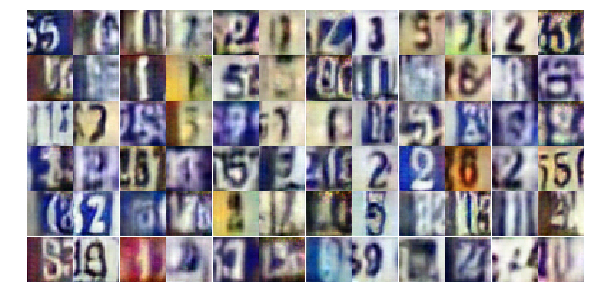

Epoch 10/10... Discriminator Loss: 1.5356... Generator Loss: 2.2017
Epoch 10/10... Discriminator Loss: 1.2697... Generator Loss: 0.5322
Epoch 10/10... Discriminator Loss: 1.0361... Generator Loss: 0.6120
Epoch 10/10... Discriminator Loss: 0.6744... Generator Loss: 1.3818
Epoch 10/10... Discriminator Loss: 0.9887... Generator Loss: 0.6958
Epoch 10/10... Discriminator Loss: 0.8124... Generator Loss: 1.2946
Epoch 10/10... Discriminator Loss: 0.9503... Generator Loss: 0.9818
Epoch 10/10... Discriminator Loss: 0.8071... Generator Loss: 0.8761
Epoch 10/10... Discriminator Loss: 1.1317... Generator Loss: 0.5326
Epoch 10/10... Discriminator Loss: 0.8802... Generator Loss: 0.8014


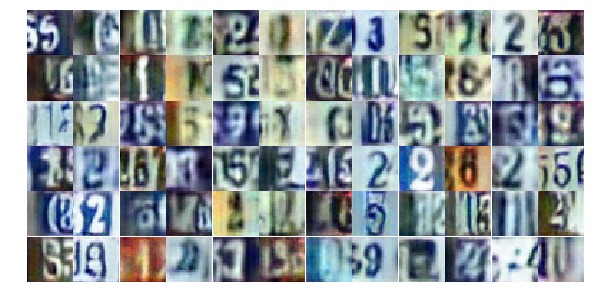

Epoch 10/10... Discriminator Loss: 0.8761... Generator Loss: 0.9566
Epoch 10/10... Discriminator Loss: 1.0073... Generator Loss: 0.6381
Epoch 10/10... Discriminator Loss: 1.0497... Generator Loss: 0.5397
Epoch 10/10... Discriminator Loss: 1.2042... Generator Loss: 0.4421
Epoch 10/10... Discriminator Loss: 1.6398... Generator Loss: 0.2937
Epoch 10/10... Discriminator Loss: 0.7068... Generator Loss: 1.0976
Epoch 10/10... Discriminator Loss: 0.7188... Generator Loss: 0.9633
Epoch 10/10... Discriminator Loss: 0.9605... Generator Loss: 0.6664
Epoch 10/10... Discriminator Loss: 1.2471... Generator Loss: 0.5150
Epoch 10/10... Discriminator Loss: 0.4833... Generator Loss: 1.2369


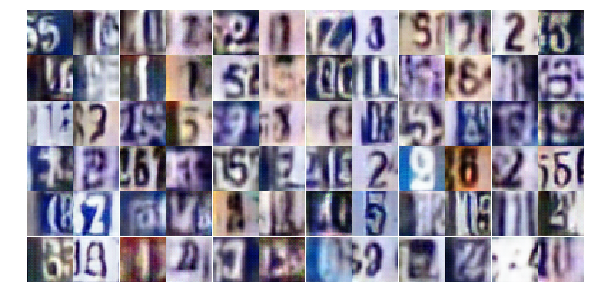

Epoch 10/10... Discriminator Loss: 1.3161... Generator Loss: 0.4378
Epoch 10/10... Discriminator Loss: 1.0246... Generator Loss: 0.7490
Epoch 10/10... Discriminator Loss: 1.0844... Generator Loss: 0.5716
Epoch 10/10... Discriminator Loss: 0.9347... Generator Loss: 0.7187
Epoch 10/10... Discriminator Loss: 1.5279... Generator Loss: 0.3912
Epoch 10/10... Discriminator Loss: 1.0383... Generator Loss: 0.6782
Epoch 10/10... Discriminator Loss: 0.9962... Generator Loss: 0.7291
Epoch 10/10... Discriminator Loss: 1.0959... Generator Loss: 0.5412
Epoch 10/10... Discriminator Loss: 0.8229... Generator Loss: 0.7916
Epoch 10/10... Discriminator Loss: 0.8699... Generator Loss: 1.2282


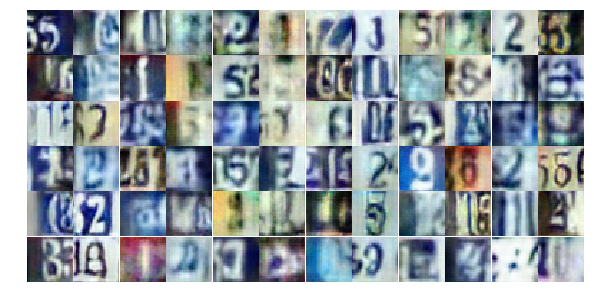

Epoch 10/10... Discriminator Loss: 0.9162... Generator Loss: 1.6562
Epoch 10/10... Discriminator Loss: 0.8001... Generator Loss: 0.9581
Epoch 10/10... Discriminator Loss: 0.9646... Generator Loss: 0.7844
Epoch 10/10... Discriminator Loss: 1.0307... Generator Loss: 0.6683
Epoch 10/10... Discriminator Loss: 0.7807... Generator Loss: 0.8889
Epoch 10/10... Discriminator Loss: 0.5002... Generator Loss: 1.2560
Epoch 10/10... Discriminator Loss: 0.7584... Generator Loss: 1.0638
Epoch 10/10... Discriminator Loss: 0.6576... Generator Loss: 1.2858
Epoch 10/10... Discriminator Loss: 1.0742... Generator Loss: 0.5704
Epoch 10/10... Discriminator Loss: 0.9520... Generator Loss: 0.8154


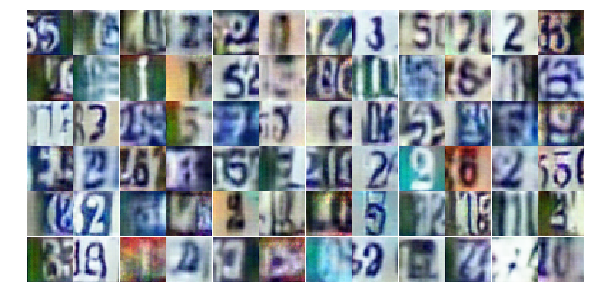

Epoch 10/10... Discriminator Loss: 0.9706... Generator Loss: 0.8099
Epoch 10/10... Discriminator Loss: 0.6988... Generator Loss: 1.1268
Epoch 10/10... Discriminator Loss: 1.2175... Generator Loss: 0.4581
Epoch 10/10... Discriminator Loss: 1.0456... Generator Loss: 1.0508
Epoch 10/10... Discriminator Loss: 1.0449... Generator Loss: 0.5286


In [63]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

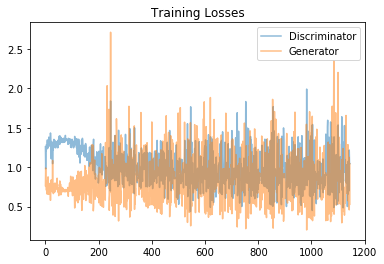

In [64]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

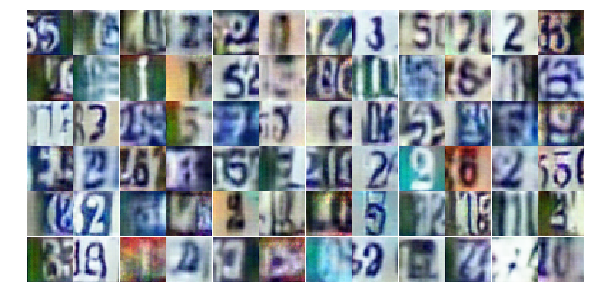

In [65]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))